In [1]:
#Load packages
import numpy as np
import pandas as pd
import scanpy as sc
import scrublet as scr
import os
import warnings
import functools
import seaborn as sns
import scipy.stats
import anndata
#import dandelion as ddl
import tables
from rpy2.robjects import r

In [2]:
from collections import defaultdict

In [2]:
#Change working directory
os.chdir("/home/jovyan/data/ClatCov/")


### 2nd round subset (fine) annotations 


In [3]:
#load data 
adata = sc.read_h5ad('COV_recluster_nd_broad_label_080721.h5ad')

## Sub-clustering for fine cell type annotation


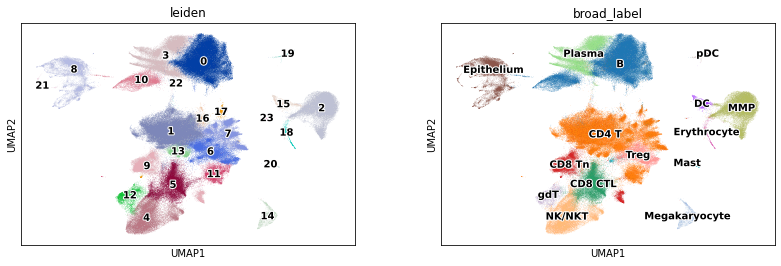

In [43]:
sc.pl.umap(adata, color=['leiden', 'broad_label'], legend_fontoutline=2, legend_loc = 'on data')

### T cell

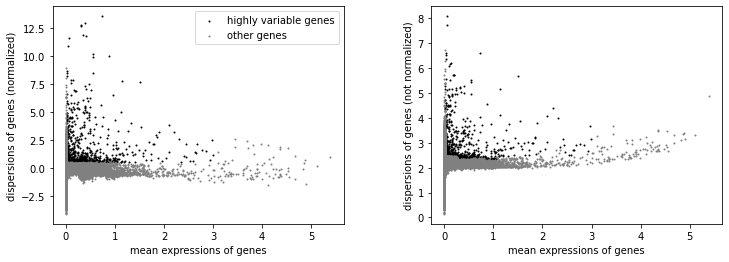

AnnData object with n_obs × n_vars = 134200 × 25675
    obs: 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'doublet_score', 'predicted_doublet', 'Sampleid', 'Patient', 'Sampletype', 'Age_group', 'Gender', 'Cohort', 'Diseasetype', 'Batch', 'Study', 'Nasal_inflammation', 'COVID_severity', 'sampleid', 'soup_correction', 'scrublet_score', 'n_genes', 'is_doublet', 'filter_rna', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'celltypist', 'combined_doublet', 'cellbender_cell', 'leiden', 'broad_label', 'fine_label', 'moderate-severe'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'hvg'

In [44]:
# subset T cell broad clusters 
rna_ = adata[adata.obs['leiden'].isin(['1','5','6','7','9','11','13','16','17'])]
rna_x = sc.AnnData(X = rna_.raw.X, obs = rna_.obs, var = rna_.raw.var)
rna_x.raw = rna_x
sc.pp.highly_variable_genes(rna_x, min_mean = 0.0125, max_mean = 3, min_disp = 0.5)
sc.pl.highly_variable_genes(rna_x)
rna_x

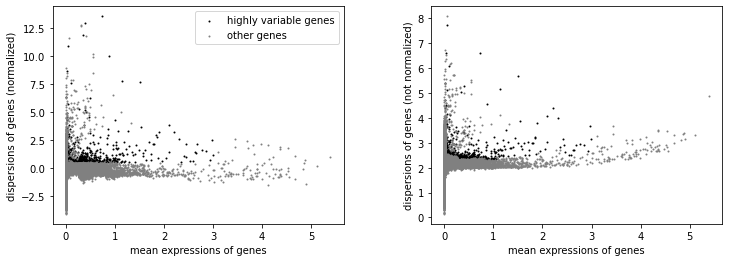

In [45]:
## remove TRBV/TRAV and IGHV/IGLV/IGKV from the highly variable genes
## allow for TRGV and TRDV so that i can do fine labelling for them
import re
for i in rna_x.var.index:
    if re.search('^TR[AB]V|^IG[HKL]V', i):
        rna_x.var.at[i, 'highly_variable'] = False
sc.pl.highly_variable_genes(rna_x)

In [46]:
# subset to highly variable
rna_x = rna_x[:, rna_x.var['highly_variable']]


In [47]:
# regress and scale for PCA
sc.pp.regress_out(rna_x, ['total_counts', 'pct_counts_mt'])


In [48]:
sc.pp.scale(rna_x, max_value = 10)

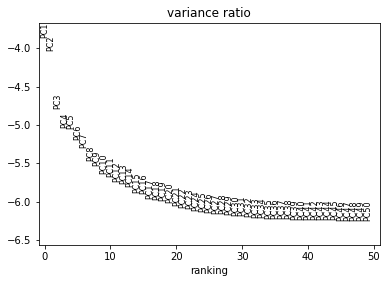

In [49]:
# Principal component analysis
sc.tl.pca(rna_x, svd_solver = 'arpack')
sc.pl.pca_variance_ratio(rna_x, log = True, n_pcs = 50)

In [50]:
# Computing the neighborhood graph. Seurat uses k = 20 as default
sc.pp.neighbors(rna_x, n_neighbors = 10, n_pcs = 50)

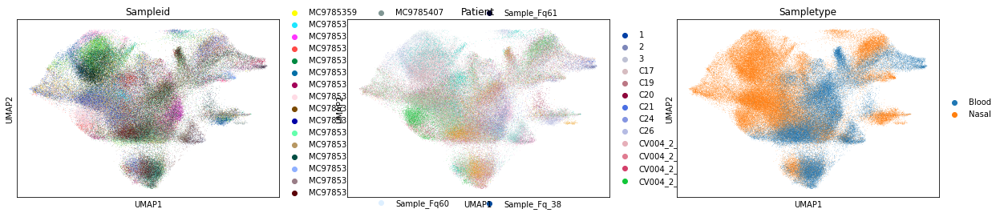

In [51]:
# run UMAP
sc.tl.umap(rna_x, n_components = 2, min_dist = 0.3)
sc.pl.umap(rna_x, color=['Sampleid','Patient', 'Sampletype'])

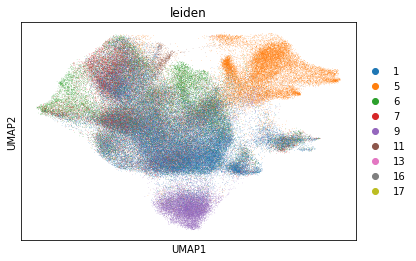

In [52]:
sc.pl.umap(rna_x, color=['leiden'])

In [62]:
# run harmony
sc.external.pp.harmony_integrate(rna_x, 'Patient')
'X_pca_harmony' in rna_x.obsm


2021-07-12 02:54:09,767 - harmonypy - INFO - Iteration 1 of 10
2021-07-12 02:56:20,424 - harmonypy - INFO - Iteration 2 of 10
2021-07-12 02:58:39,253 - harmonypy - INFO - Converged after 2 iterations


True

In [68]:
rna_x

AnnData object with n_obs × n_vars = 134200 × 751
    obs: 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'doublet_score', 'predicted_doublet', 'Sampleid', 'Patient', 'Sampletype', 'Age_group', 'Gender', 'Cohort', 'Diseasetype', 'Batch', 'Study', 'Nasal_inflammation', 'COVID_severity', 'sampleid', 'soup_correction', 'scrublet_score', 'n_genes', 'is_doublet', 'filter_rna', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'celltypist', 'combined_doublet', 'cellbender_cell', 'leiden', 'broad_label', 'fine_label', 'moderate-severe', 'leiden_R'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'pca', 'neighbors', 'umap', 'Sampleid_colors', 'Patient_colors', 'Sampletype_colors', 'leiden_colors', 'leiden', 'leiden_R_colors'
    obsm: 'X_pca', 'X_umap', 'X_pca

In [69]:
# Computing the neighborhood graph. Seurat uses k = 20 as default
sc.pp.neighbors(rna_x, n_neighbors = 10, n_pcs = 50, use_rep='X_pca_harmony')

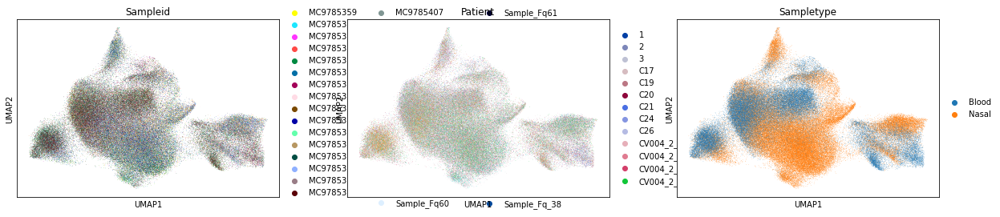

In [70]:
# UMAP
sc.tl.umap(rna_x, n_components = 2, min_dist = 0.3)
sc.pl.umap(rna_x, color=['Sampleid','Patient', 'Sampletype'])

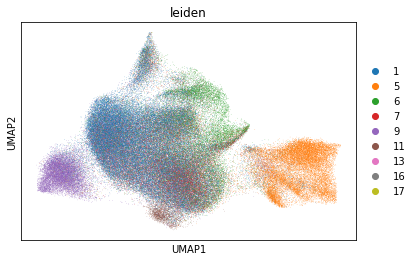

In [71]:
sc.pl.umap(rna_x, color=['leiden'])

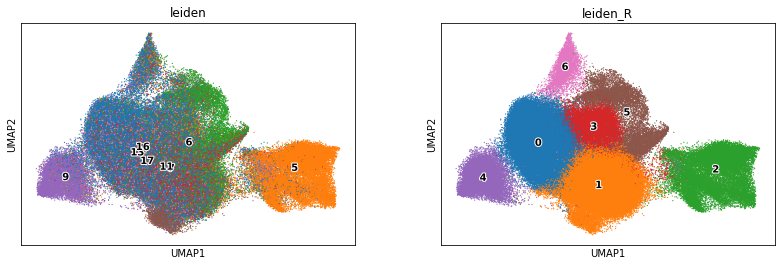

In [72]:
# find clusters
sc.tl.leiden(rna_x, resolution = 0.5, key_added = 'leiden_R')
sc.pl.umap(rna_x, color=['leiden', 'leiden_R'], size=6, legend_loc ='on data', legend_fontoutline=2)

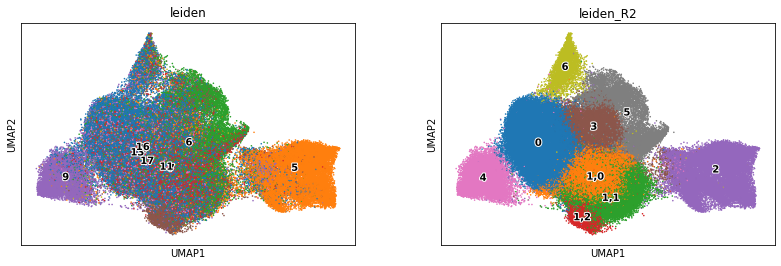

In [77]:
# split specific clusters
sc.tl.leiden(rna_x, resolution = .4, key_added = 'leiden_R2', restrict_to =('leiden_R', ['1']))
sc.pl.umap(rna_x, color=['leiden', 'leiden_R2'], size=10, legend_loc ='on data', legend_fontoutline=2)

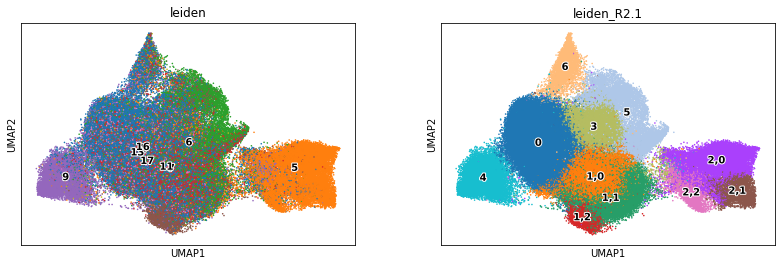

In [81]:
# split specific clusters
sc.tl.leiden(rna_x, resolution = .2, key_added = 'leiden_R2.1', restrict_to =('leiden_R2', ['2']))
sc.pl.umap(rna_x, color=['leiden', 'leiden_R2.1'], size=10, legend_loc ='on data', legend_fontoutline=2)

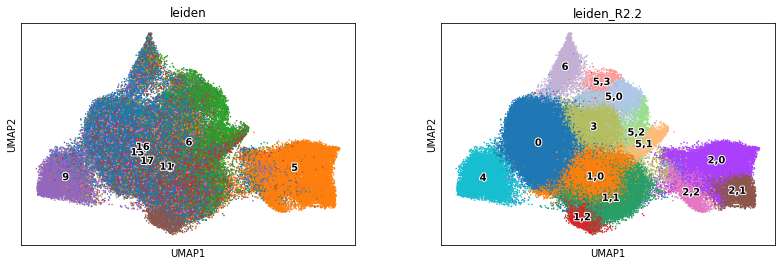

In [95]:
# split specific clusters
sc.tl.leiden(rna_x, resolution = .3, key_added = 'leiden_R2.2', restrict_to =('leiden_R2.1', ['5']))
sc.pl.umap(rna_x, color=['leiden', 'leiden_R2.2'], size=10, legend_loc ='on data', legend_fontoutline=2)

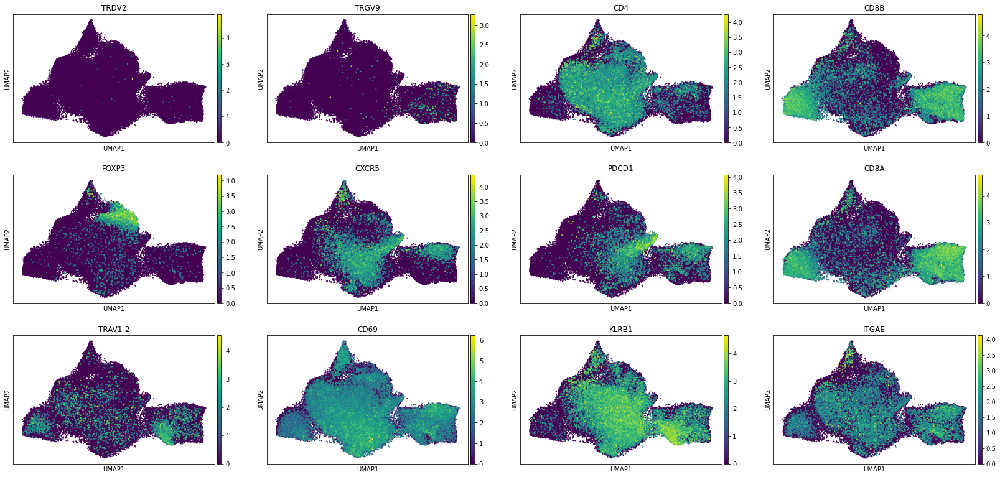

In [73]:
sc.pl.umap(rna_x, color = ['TRDV2', 'TRGV9', 'CD4', 'CD8B', 'FOXP3', 'CXCR5', 'PDCD1', 'CD8A','TRAV1-2', 'CD69', 'KLRB1','ITGAE'], size = 20)

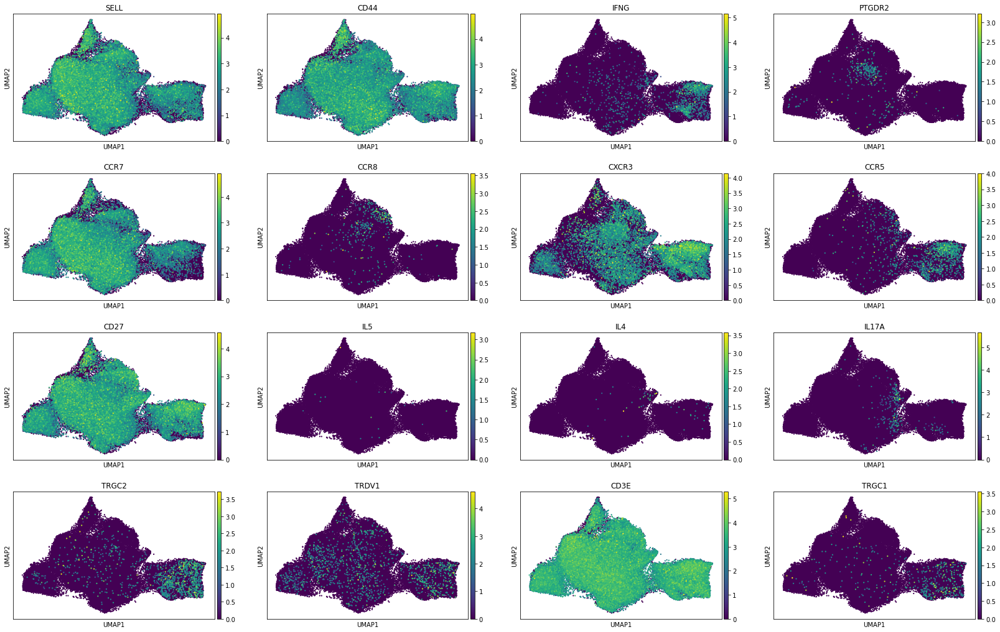

In [74]:
sc.pl.umap(rna_x, color = ['SELL', 'CD44','IFNG', 'PTGDR2','CCR7','CCR8','CXCR3','CCR5','CD27', 'IL5', 'IL4', 'IL17A', 'TRGC2', 'TRDV1', 'CD3E','TRGC1'], size = 20)

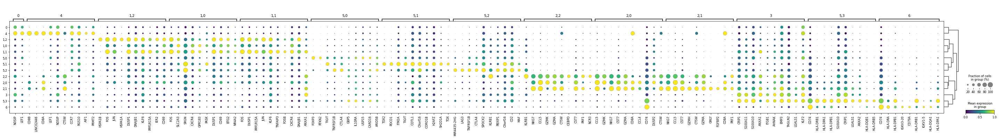

In [96]:
sc.tl.rank_genes_groups(rna_x, groupby = 'leiden_R2.2', method = 'wilcoxon')
sc.tl.filter_rank_genes_groups(rna_x, min_fold_change=1)
sc.tl.dendrogram(rna_x, groupby = 'leiden_R2.2')
sc.pl.rank_genes_groups_dotplot(rna_x, n_genes = 10, standard_scale = 'var', color_map = 'viridis', key = 'rank_genes_groups_filtered')

In [ ]:
#cluster labels from Chua et al. Nat Biotech 2020
Chuafeat = ['TP63', 'KRT5', 'S100A2', 'FABP5', 'SERPINB3', 'TMSB4X', 'IFIT1', 'IFIT2', 'IFITM3', 'ISG15', 'ISG20', 'OAS1', 'SCGB1A1', 'SCGB3A1', 'XBP1', 'VMO1', 'MUC5AC', 'PIGR', 'FOXN4', 'CCNO', 'MYCL', 'CDC20B', 'TUBA1B', 'PCM1', 'FOXJ1', 'EFHC1', 'CCDC153', 
              'CCDC113', 'MLF1', 'LZTFL1', 'FOXI1', 'CFTR', 'ASCL3', 'FOXI2', 'SFTPB', 'ANK2', 'SFTPB', 'ANK2', 'SPRR1A', 'SPRR2A', 'SPRR2D', 'SPRR2E', 'SPRR3', 'TMPRSS11E', 'IL1B', 'VCAN', 'CD14', 'CCL2', 'FCGR3A', 'CXCL10', 'IFIT1', 'CD68', 'FABP5', 'FCER1A', 'CD74', 'HLA-DQB1',
              'HLA-DRA', 'JCHAIN', 'APOE', 'NCAM1', 'HMGB2', 'STMN1', 'FOXP3', 'CTLA4', 'TNFRSF18', 'CD4', 'CD8B', 'CD8A', 'PRF1', 'GZMA', 'GZMB', 'GNLY', 'NKG7', 'CD3G', 'CD3E', 'KLRB1', 'IL32', 'S100A4', 'CD27', 'CD19', 'MS4A1', 'CD79A', 'IRF7', 'TLR7', 'CLEC4C', 'IL3RA', 'LYN', 
              'FCGR3B', 'ITGAX', 'HPGD', 'LTC4S', 'CPA3','CD69', 'ITGA1', 'KIT', 'HBB', 'PPBP']
Chuafeat

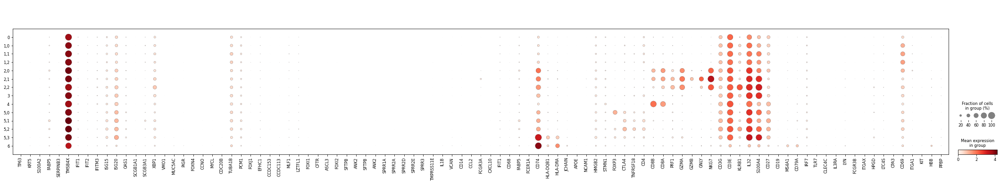

In [97]:
sc.pl.dotplot(rna_x, Chuafeat, groupby = 'leiden_R2.2')

In [ ]:
#Marker genes for lung celltypes from Travaglini 2020 nature
Trav_list = ['FOXJ1','KRT5','MUC5B',
   'MUC5B',
   'PRR4',
   'CFTR',
   'CALCA',
   'DCLK1',
   'AGER',
   'SFTPB',
   'ACKR1',
   'CA4',
   'PROX1',
   'CNN1',
   'CNN1',
   'COL1A1',
   'COL1A1',
   'COL1A1',
   'CSPG4',
   'MSLN',
   'SNAP25',
   'CD79A',
   'CD79A',
   'CD3E',
   'CD3E',
   'CD3E',
   'CD3E',
   'KLRD1',
   'CD3E',
   'S100A8',
   'MS4A2',
   'MS4A2',
   'SIGLEC8',
   'NRGN',
   'MARCO',
   'LILRB4',
   'CLEC9A',
   'CD14',
  'SCGB3A2',
   'TUBB1',
   'KRT14',
   'MUC5AC',
   'LPO',
   'FOXI1',
   'CHGA',
   'ASCL2',
   'PDPN',
   'BMX',
   'PDPN',
   'ACTA2',
   'PDGFRA',
   'TRPC6',
   'UPK3B',
   'CD24',
   'CD27',
   'CD8A',
   'CD4',
   'NKG7',
   'CD8B',
   'S100A9',
   'CPA3',
   'PPBP',
   'MSR1',
   'IRF8',
   'LAMP3',
   'CD1C',
   'S100A8',
   'TP73',
   'TP63',
   'SPDEF',
   'LTF',
   'ASCL3',
   'ASCL1',
   'CLIC5',
   'TAGLN',
   'ELN',
   'PLIN2',
   'PDGFRB',
   'MS4A1',
   'SLAMF7',
   'GZMK',
   'COTL1',
   'CCR7',
   'TYROBP',
   'FCER1G',
   'IFITM2',
   'TPSAB1',
   'PF4',
   'MRC1',
   'LILRA4',
   'PLD4',
   'FCGR3A',
   'CCDC78',
   'DAPL1',
   'MUC1',
   'RGS5',
   'DES',
   'ACTA2',
   'APOE',
   'CD19',
   'DUSP2',
   'GZMB',
   'LDHB',
   'LEF1',
   'TYROBP',
   'FCGR3B',
   'OST4',
   'ETV5', 
   'LGR6']
Trav_list

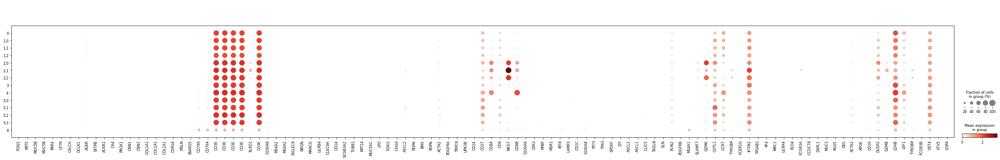

In [98]:
sc.pl.dotplot(rna_x, Trav_list, groupby = 'leiden_R2.2')

In [ ]:
#ILC marker geneset Bjorkland Nature Immuno 2016
ILC_Bjorkland = ['CCL3',
'CXCR3',
'IFNG',
'IL12RB1',
'TBX21',
'PTGDR2',
'IL17RB',
'IL1RL1',
'IL13',
'GATA3',
'NCR2',
'IL22',
'RORC',
'AHR',
'IL23R',
'IL1R1',
'EOMES',
'GZMA',
'GNLY',
'KLRC1']

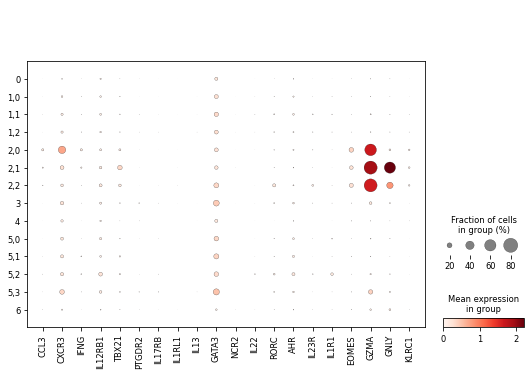

In [99]:
sc.pl.dotplot(rna_x, ILC_Bjorkland, groupby = 'leiden_R2.2')

In [37]:
#Zhang 2020 Nature immuno COVID blood/blaf T cell single cell subset markers 
Zhang2020_T = ['CD3E',
              'CD4',
              'CD8A',
              'CCR7',
              'SELL',
              'TCF7',
              'LEF1',
              'LTB',
              'S100A4',
              'GPR183',
              'CD69',
              'GZMK',
              'GZMA',
              'GZMB',
              'GNLY',
              'NKG7',
              'FOXP3',
              'IL2RA',
              'TIGIT',
              'HAVCR2',
              'CTLA4',
              'LAG3',
              'PDCD1',
              'TOX',
              'FCGR3A',
              'KIR3DL2',
              'TYROBP',
              'NCAM1',
              'CD160']

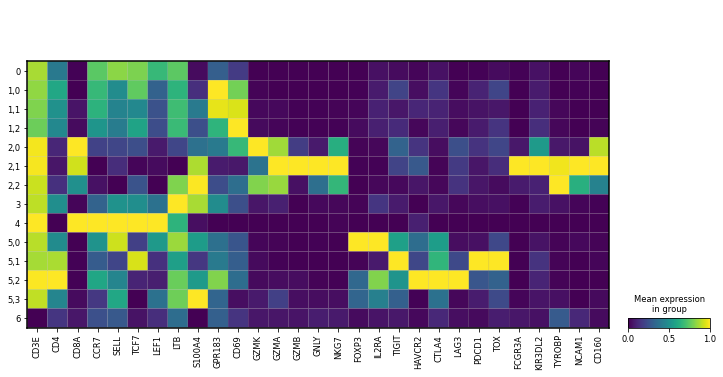

In [100]:
#Matrixplt scaled to max-min values 
sc.pl.matrixplot(rna_x, Zhang2020_T, groupby = 'leiden_R2.2', standard_scale = 'var')

In [88]:
#Donna faber COVID T cell subset markers 
faber = ['TRAC',
        'TRDC',
         'CD3E',
        'CD4',
        'CD8A',
        'CD8B',
        'SELL',
        'CCR7',
         'CD44',
        'LEF1',
        'KLF2',
        'TCF7',
        'ENO1',
        'LDHA',
        'FOXP3',
        'IL2RA',
        'TIGIT',
        'CD28',
        'PDCD1',
        'CXCR5',
        'ICOS',
        'CCL5',
        'GNLY',
        'KLRB1',
        'CD69',
        'ITGAE',
        'CXCR6',
        'ITGA1',
        'B3GAT1',
        'HNRNPLL',
        'CD244',
        'PRF1',
        'IL17A',
        'PTGDR2',
         'EOMES',
         'TBX21',
        'CXCR3',
         'GATA3',
        'CCR5',
        'IL7R',
        'STAT4']

In [109]:
#Selection of key markers for T cell subset for display purposes 
Tcellplot = ['CD3E',
            'CD4',
            'CD8B',
            'SELL',
            'CCR7',
            'CD44',
            'IL17A',
            'STAT4',
            'PTGDR2',
            'GATA3',
             'CD69',
             'ITGAE',
             'ITGA1',
            'PRF1',
             'GZMA',
            'GZMB',
             'GZMK',
             'TRAV1-2',
             'KLRB1',
            'TIGIT',
            'PDCD1',
            'ICOS',
            'FOXP3',
            'CTLA4',
            'HLA-DRA',
            'S100A4']

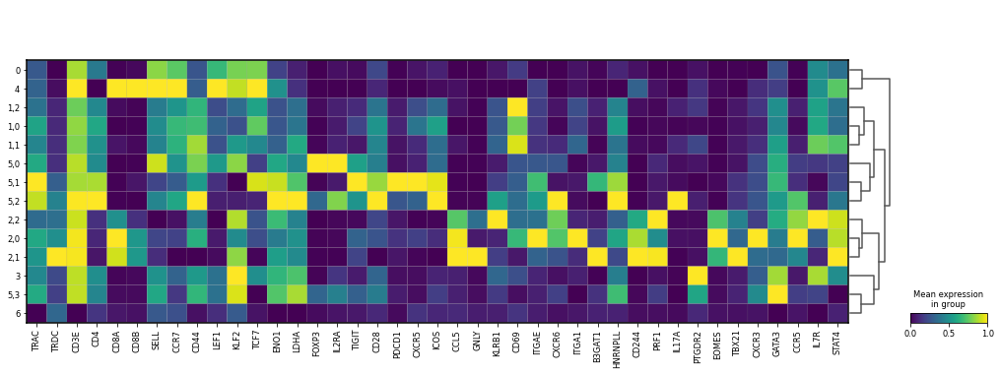

In [101]:
sc.pl.matrixplot(rna_x, faber, groupby = 'leiden_R2.2', dendrogram = True, standard_scale = 'var')

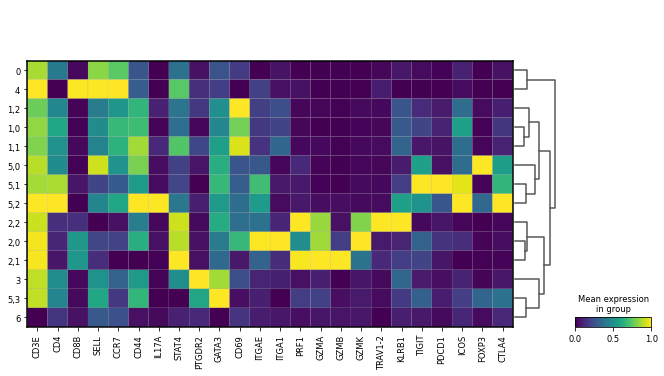

In [105]:
sc.pl.matrixplot(rna_x, Tcellplot, groupby = 'leiden_R2.2', dendrogram = True, standard_scale = 'var')

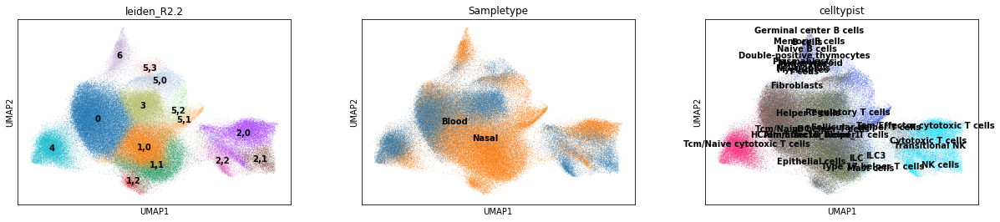

In [103]:
sc.pl.umap(rna_x, color=['leiden_R2.2', 'Sampletype', 'celltypist'], legend_loc='on data')

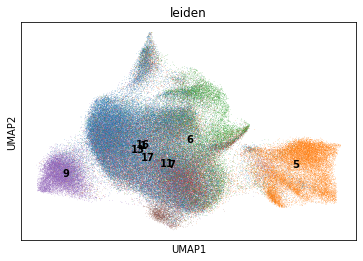

In [106]:
sc.pl.umap(rna_x, color=['leiden'], legend_loc='on data')

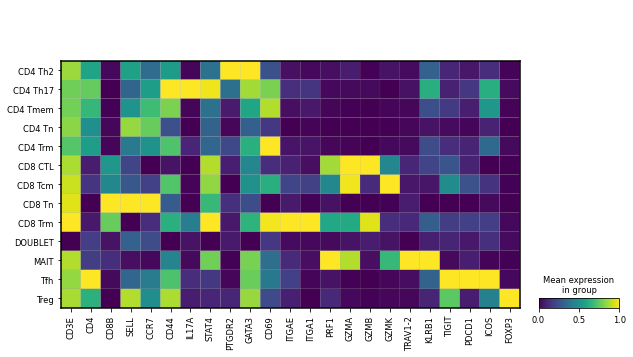

In [254]:
sc.pl.matrixplot(rna_x, Tcellplot, groupby = 'fine_label', standard_scale = 'var')

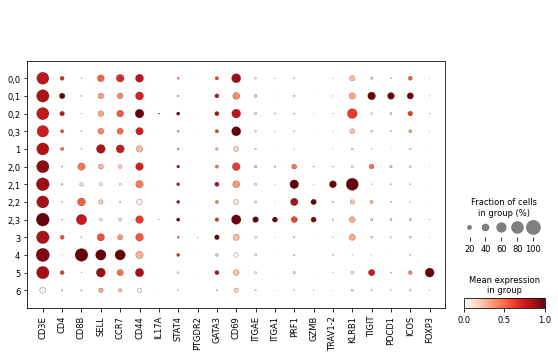

In [251]:
sc.pl.dotplot(rna_x, Tcellplot, groupby = 'leiden_R2.1', standard_scale = 'var')

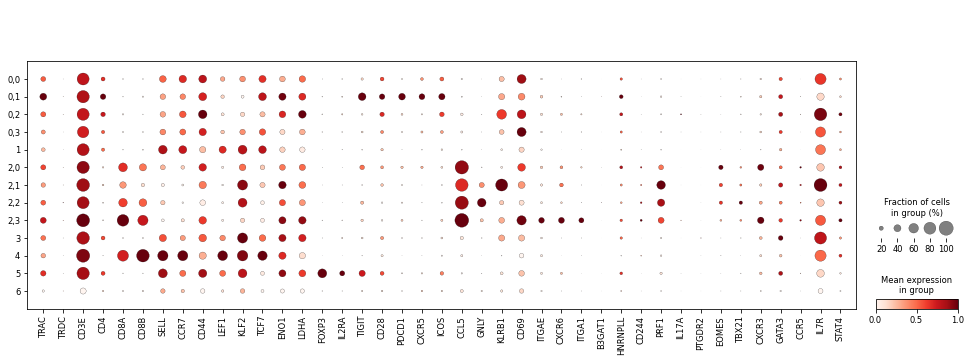

In [252]:
sc.pl.dotplot(rna_x, faber, groupby = 'leiden_R2.1', standard_scale = 'var')

... storing 'subset_annotations' as categorical


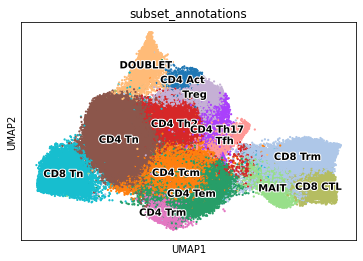

In [107]:
#Add new labels to slot subset annotations 
new_dict1 = {'0':'CD4 Tn',
'1,0':'CD4 Tcm',
'1,1':'CD4 Tem',
'1,2':'CD4 Trm',
'2,0':'CD8 Trm',
'2,1':'CD8 CTL',
'2,2':'MAIT',
'3':'CD4 Th2',
'4':'CD8 Tn',
'5,0':'Treg',
'5,1':'Tfh',
'5,2':'CD4 Th17',
'5,3':'CD4 Act',
'6':'DOUBLET'}
rna_x.obs['subset_annotations'] = [new_dict1[l] for l in rna_x.obs['leiden_R2.2']]
sc.pl.umap(rna_x, color=['subset_annotations'], size=20, legend_loc ='on data', legend_fontoutline=2)

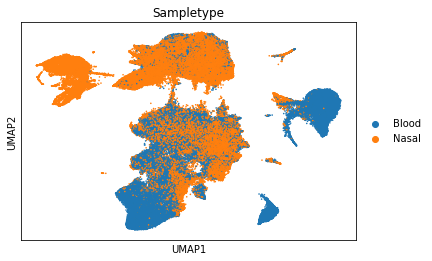

In [114]:
sc.pl.umap(adata, color = ['Sampletype'], size =10)

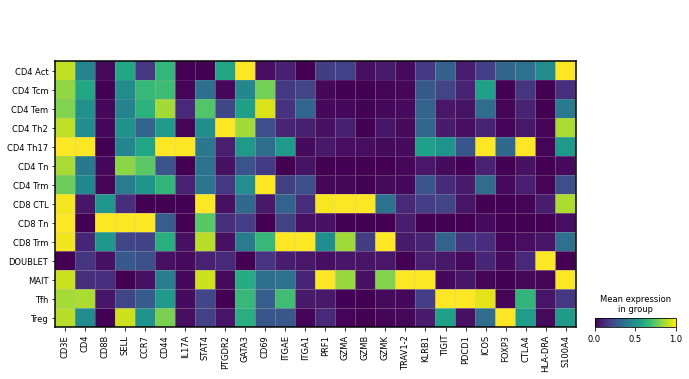

In [110]:
sc.pl.matrixplot(rna_x, Tcellplot, groupby = 'subset_annotations', standard_scale = 'var')

In [247]:
adata

AnnData object with n_obs × n_vars = 297889 × 1413
    obs: 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'doublet_score', 'predicted_doublet', 'Sampleid', 'Patient', 'Sampletype', 'Age_group', 'Gender', 'Cohort', 'Diseasetype', 'Batch', 'Study', 'Nasal_inflammation', 'COVID_severity', 'sampleid', 'soup_correction', 'scrublet_score', 'n_genes', 'is_doublet', 'filter_rna', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'celltypist', 'combined_doublet', 'cellbender_cell', 'leiden', 'broad_label', 'fine_label', 'moderate-severe'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'pca', 'neighbors', 'umap', 'Sampleid_colors', 'Patient_colors', 'Sampletype_colors', 'leiden', 'Gender_colors', 'leiden_colors', 'Cohort_colors', 'celltypist_colors', 'rank_gen

In [121]:
adata.obs['subset_annotations'] = adata.obs['leiden'] 

... storing 'subset_annotation' as categorical
... storing 'subset_annotations' as categorical


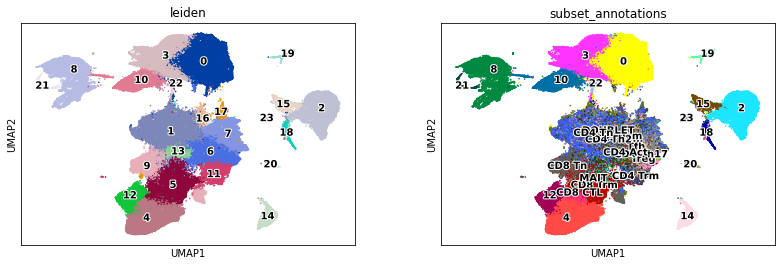

In [122]:
# update the original object
adata.obs['subset_annotations'] = adata.obs['subset_annotations'].astype('object')
adata.obs['subset_annotations'].update(rna_x.obs['subset_annotations'].astype('object'))
sc.pl.umap(adata, color = ['leiden', 'subset_annotations'], size = 10, legend_loc = 'on data', legend_fontoutline=2)

In [249]:
#save for now
adata_concat.write('COV_nd_T-fine_label_120721.h5ad', compression = 'gzip')
adata_concat.raw.to_adata().write('COV_nd_T_fine_label_raw_120721.h5ad', compression = 'gzip')

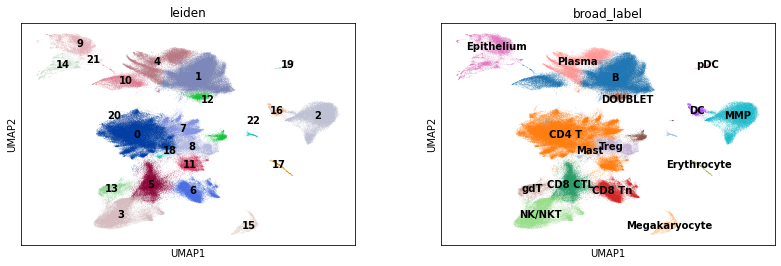

In [8]:
sc.pl.umap(adata, color=['leiden','broad_label'], legend_loc = 'on data')

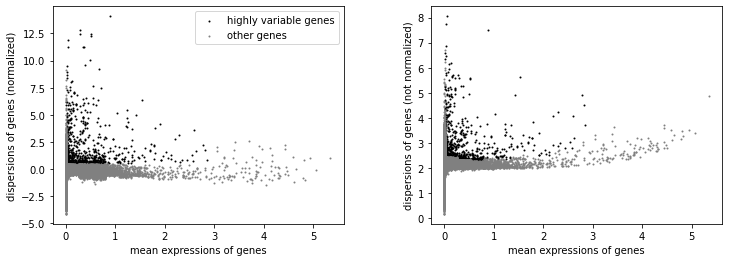

AnnData object with n_obs × n_vars = 161213 × 25675
    obs: 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'doublet_score', 'predicted_doublet', 'Sampleid', 'Patient', 'Sampletype', 'Age_group', 'Gender', 'Cohort', 'Diseasetype', 'Batch', 'Study', 'Nasal_inflammation', 'COVID_severity', 'sampleid', 'soup_correction', 'scrublet_score', 'n_genes', 'is_doublet', 'filter_rna', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'celltypist', 'combined_doublet', 'cellbender_cell', 'leiden', 'broad_label', 'fine_label', 'moderate-severe', 'subset_annotation', 'subset_annotations'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'hvg'

In [339]:
# also subset T/NK etc together just for graphical purposes
rna_ = adata[adata.obs['leiden'].isin(['1','5','6','7','9','11','13','16','17',
                                      '4', '12','20'])]
rna_x = sc.AnnData(X = rna_.raw.X, obs = rna_.obs, var = rna_.raw.var)
rna_x.raw = rna_x
sc.pp.highly_variable_genes(rna_x, min_mean = 0.0125, max_mean = 3, min_disp = 0.5)
sc.pl.highly_variable_genes(rna_x)
rna_x

### NK/mast/gdT cell

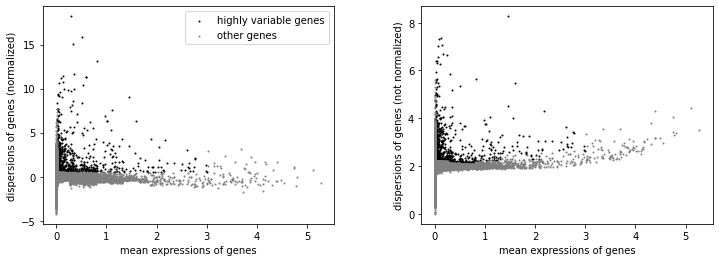

AnnData object with n_obs × n_vars = 28771 × 25675
    obs: 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'doublet_score', 'predicted_doublet', 'Sampleid', 'Patient', 'Sampletype', 'Age_group', 'Gender', 'Cohort', 'Diseasetype', 'Batch', 'Study', 'Nasal_inflammation', 'COVID_severity', 'sampleid', 'soup_correction', 'scrublet_score', 'n_genes', 'is_doublet', 'filter_rna', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'celltypist', 'combined_doublet', 'cellbender_cell', 'leiden', 'broad_label', 'fine_label', 'moderate-severe'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'Cohort_colors', 'Gender_colors', 'Patient_colors', 'Sampleid_colors', 'Sampletype_colors', 'celltypist_colors', 'dendrogram_leiden', 'fine_label_colors', 'hvg', 'leiden', 'leiden_colors', 'neighbors

In [9]:
# subset
rna_ = adata[adata.obs['leiden'].isin(['3', '13','18'])]
rna_x = sc.AnnData(X = rna_.raw.X, obs = rna_.obs, var = rna_.raw.var, uns = rna_.uns, obsm = rna_.obsm, obsp = rna_.obsp)
rna_x.raw = rna_x
sc.pp.highly_variable_genes(rna_x, min_mean = 0.0125, max_mean = 3, min_disp = 0.5)
sc.pl.highly_variable_genes(rna_x)
rna_x

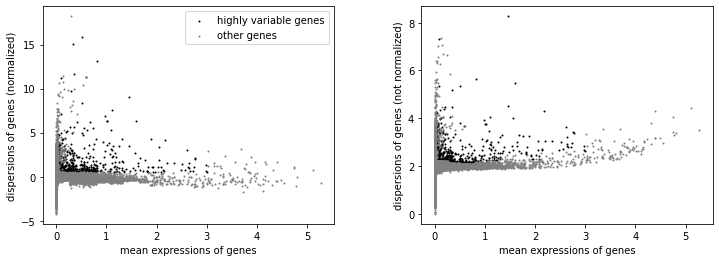

In [10]:
## remove TRBV/TRAV and IGHV/IGLV/IGKV from the highly variable genes
## keep TCR gammadelta genes
import re
for i in rna_x.var.index:
    if re.search('^TR[AB]V|^IG[HKL]V', i):
        rna_x.var.at[i, 'highly_variable'] = False
sc.pl.highly_variable_genes(rna_x)

In [11]:
# subset to highly variable
rna_x = rna_x[:, rna_x.var['highly_variable']]
# regress and scale for PCA
sc.pp.regress_out(rna_x, ['total_counts', 'pct_counts_mt'])
sc.pp.scale(rna_x, max_value = 10)

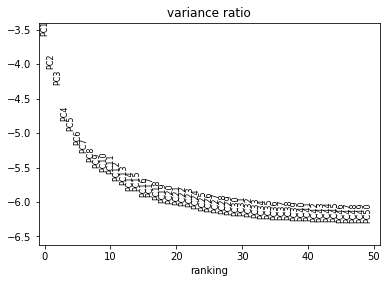

In [12]:
# Principal component analysis
sc.tl.pca(rna_x, svd_solver = 'arpack')
sc.pl.pca_variance_ratio(rna_x, log = True, n_pcs = 50)

In [13]:
# Computing the neighborhood graph. Seurat uses k = 20 as default
sc.pp.neighbors(rna_x, n_neighbors = 10, n_pcs = 50)

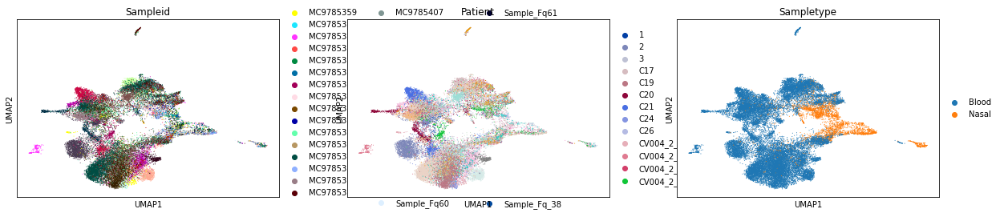

In [14]:
# run UMAP
sc.tl.umap(rna_x, n_components = 2, min_dist = 0.3)
sc.pl.umap(rna_x, color=['Sampleid','Patient', 'Sampletype'])

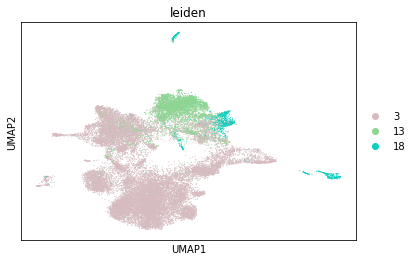

In [15]:
sc.pl.umap(rna_x, color=['leiden'])

In [16]:
# run harmony
sc.external.pp.harmony_integrate(rna_x, 'Patient')
'X_pca_harmony' in rna_x.obsm


2021-07-14 08:43:25,026 - harmonypy - INFO - Iteration 1 of 10
2021-07-14 08:43:48,204 - harmonypy - INFO - Iteration 2 of 10
2021-07-14 08:44:11,515 - harmonypy - INFO - Iteration 3 of 10
2021-07-14 08:44:35,090 - harmonypy - INFO - Iteration 4 of 10
2021-07-14 08:44:48,316 - harmonypy - INFO - Iteration 5 of 10
2021-07-14 08:44:59,891 - harmonypy - INFO - Iteration 6 of 10
2021-07-14 08:45:09,916 - harmonypy - INFO - Iteration 7 of 10
2021-07-14 08:45:19,504 - harmonypy - INFO - Iteration 8 of 10
2021-07-14 08:45:29,302 - harmonypy - INFO - Iteration 9 of 10
2021-07-14 08:45:39,107 - harmonypy - INFO - Converged after 9 iterations


True

In [17]:
rna_x

AnnData object with n_obs × n_vars = 28771 × 924
    obs: 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'doublet_score', 'predicted_doublet', 'Sampleid', 'Patient', 'Sampletype', 'Age_group', 'Gender', 'Cohort', 'Diseasetype', 'Batch', 'Study', 'Nasal_inflammation', 'COVID_severity', 'sampleid', 'soup_correction', 'scrublet_score', 'n_genes', 'is_doublet', 'filter_rna', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'celltypist', 'combined_doublet', 'cellbender_cell', 'leiden', 'broad_label', 'fine_label', 'moderate-severe'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'Cohort_colors', 'Gender_colors', 'Patient_colors', 'Sampleid_colors', 'Sampletype_colors', 'celltypist_colors', 'dendrogram_leiden', 'fine_label_colors', 'hvg', 'leiden', 'leiden_colors

In [18]:
# Computing the neighborhood graph. Seurat uses k = 20 as default
sc.pp.neighbors(rna_x, n_neighbors = 10, n_pcs = 50, use_rep='X_pca_harmony')

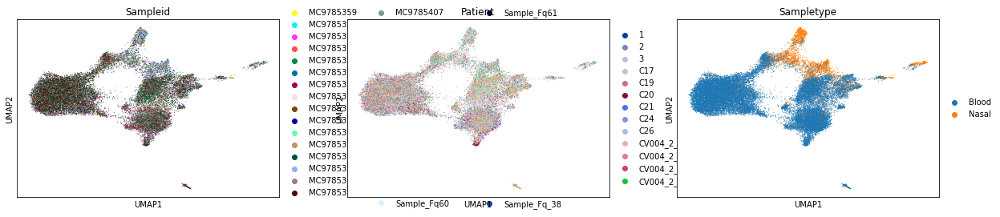

In [19]:
# UMAP
sc.tl.umap(rna_x, n_components = 2, min_dist = 0.3)
sc.pl.umap(rna_x, color=['Sampleid','Patient', 'Sampletype'])

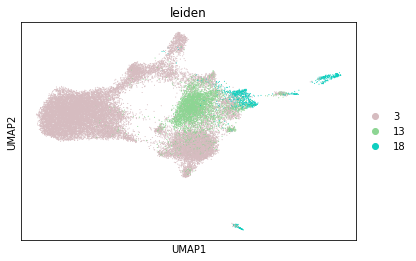

In [20]:
sc.pl.umap(rna_x, color=['leiden'])

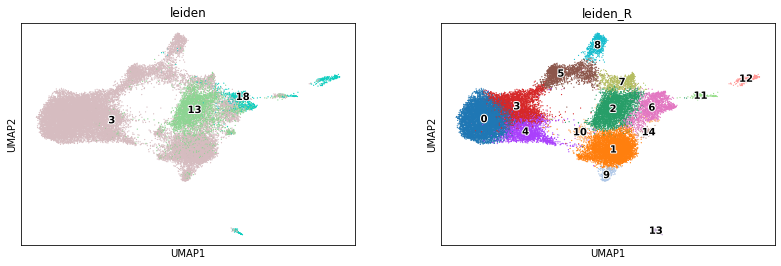

In [21]:
# find clusters
sc.tl.leiden(rna_x, resolution = 1, key_added = 'leiden_R')
sc.pl.umap(rna_x, color=['leiden', 'leiden_R'], size=6, legend_loc ='on data', legend_fontoutline=2)

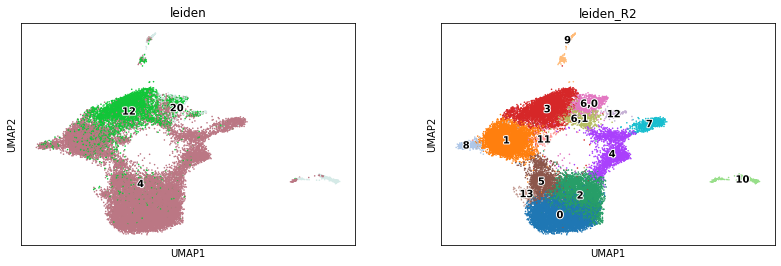

In [140]:
# split clusters
sc.tl.leiden(rna_x, resolution = .3, key_added = 'leiden_R2', restrict_to = ('leiden_R', ['6']))
sc.pl.umap(rna_x, color=['leiden', 'leiden_R2'], size=10, legend_loc ='on data', legend_fontoutline=2)

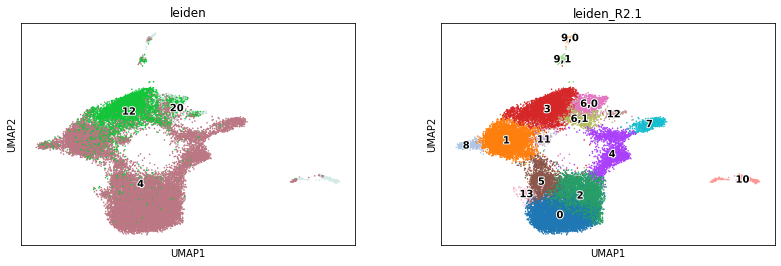

In [149]:
# split clusters
sc.tl.leiden(rna_x, resolution = .3, key_added = 'leiden_R2.1', restrict_to = ('leiden_R2', ['9']))
sc.pl.umap(rna_x, color=['leiden', 'leiden_R2.1'], size=10, legend_loc ='on data', legend_fontoutline=2)

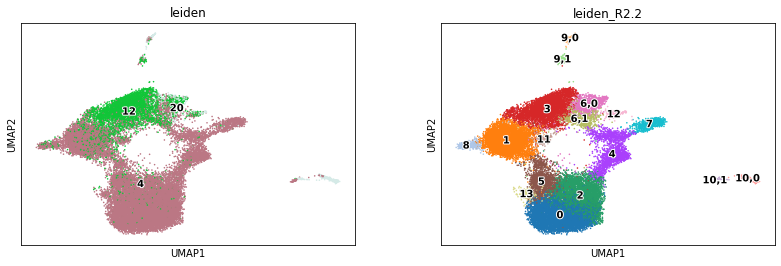

In [151]:
# split clusters
sc.tl.leiden(rna_x, resolution = .2, key_added = 'leiden_R2.2', restrict_to = ('leiden_R2.1', ['10']))
sc.pl.umap(rna_x, color=['leiden', 'leiden_R2.2'], size=10, legend_loc ='on data', legend_fontoutline=2)

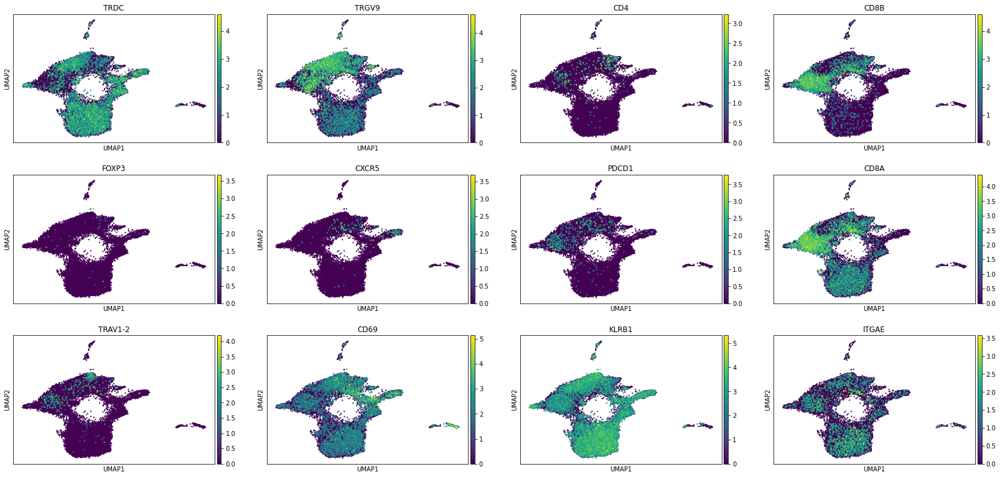

In [137]:
sc.pl.umap(rna_x, color = ['TRDC', 'TRGV9', 'CD4', 'CD8B', 'FOXP3', 'CXCR5', 'PDCD1', 'CD8A','TRAV1-2', 'CD69', 'KLRB1','ITGAE'], size = 20)

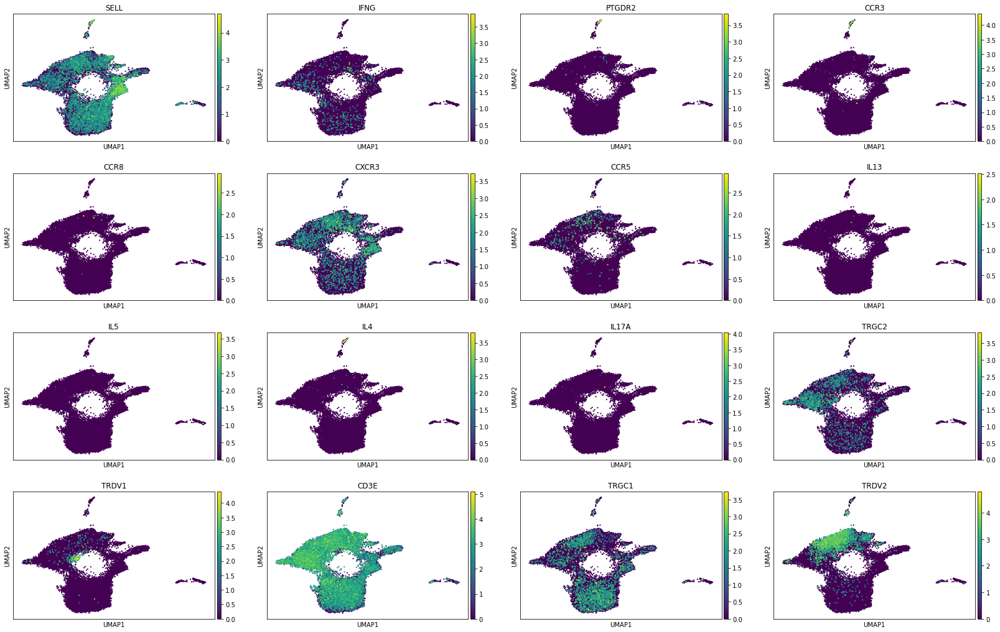

In [138]:
sc.pl.umap(rna_x, color = ['SELL', 'IFNG', 'PTGDR2','CCR3','CCR8','CXCR3','CCR5','IL13', 'IL5', 'IL4', 'IL17A', 'TRGC2', 'TRDV1', 'CD3E','TRGC1', 'TRDV2'], size = 20)

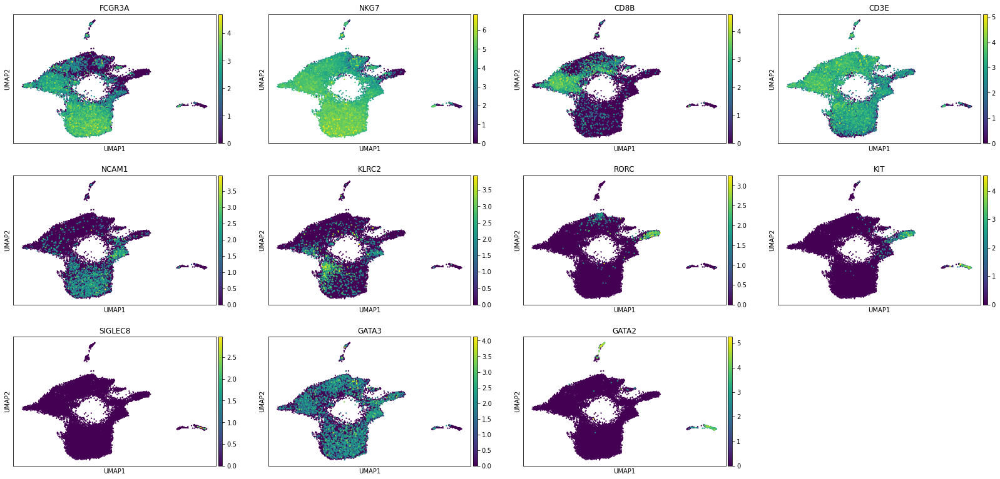

In [139]:
sc.pl.umap(rna_x, color = ['FCGR3A', 'NKG7','CD8B','CD3E','NCAM1','KLRC2','RORC','KIT', 'SIGLEC8','GATA3','GATA2'], size = 20)

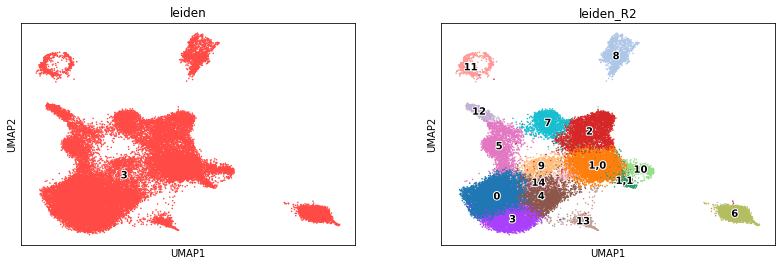

In [185]:
# split specific clusters
#sc.tl.leiden(rna_x, resolution = .3, key_added = 'leiden_R2', restrict_to =('leiden_R', ['1']))
#sc.pl.umap(rna_x, color=['leiden', 'leiden_R2'], size=10, legend_loc ='on data', legend_fontoutline=2)

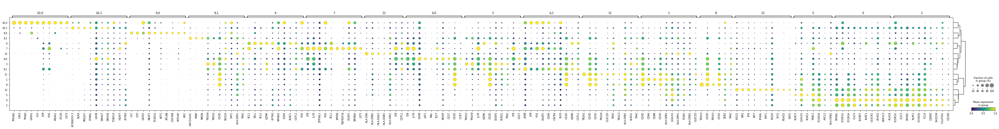

In [152]:
sc.tl.rank_genes_groups(rna_x, groupby = 'leiden_R2.2', method = 'wilcoxon')
sc.tl.filter_rank_genes_groups(rna_x, min_fold_change=1)
sc.tl.dendrogram(rna_x, groupby = 'leiden_R2.2')
sc.pl.rank_genes_groups_dotplot(rna_x, n_genes = 10, standard_scale = 'var', color_map = 'viridis', key = 'rank_genes_groups_filtered')

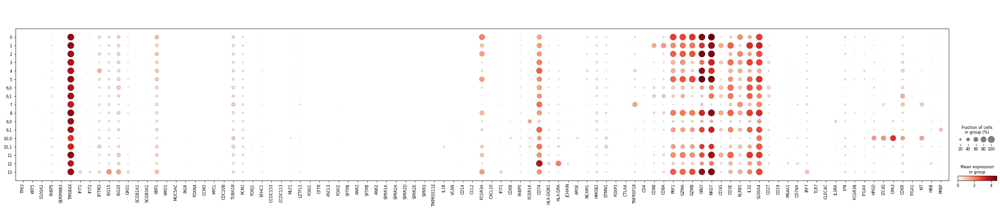

In [153]:
sc.pl.dotplot(rna_x, Chuafeat, groupby = 'leiden_R2.2')

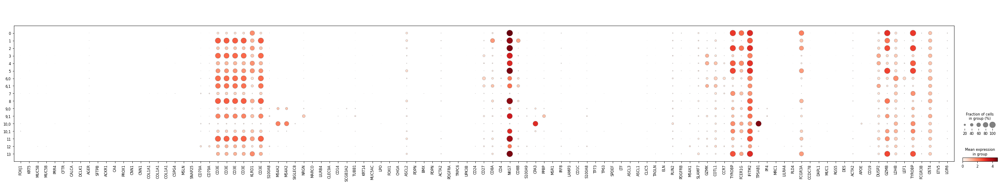

In [154]:
sc.pl.dotplot(rna_x, Trav_list, groupby = 'leiden_R2.2')

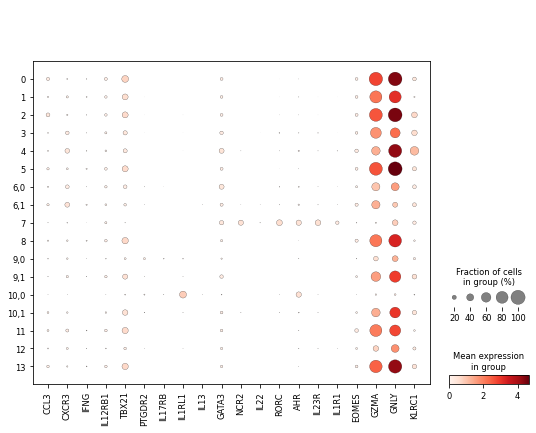

In [155]:
sc.pl.dotplot(rna_x, ILC_Bjorkland, groupby = 'leiden_R2.2')

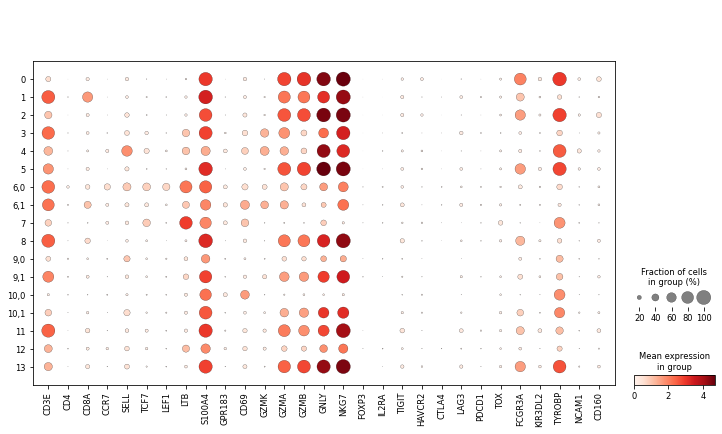

In [156]:
sc.pl.dotplot(rna_x, Zhang2020_T, groupby = 'leiden_R2.2')

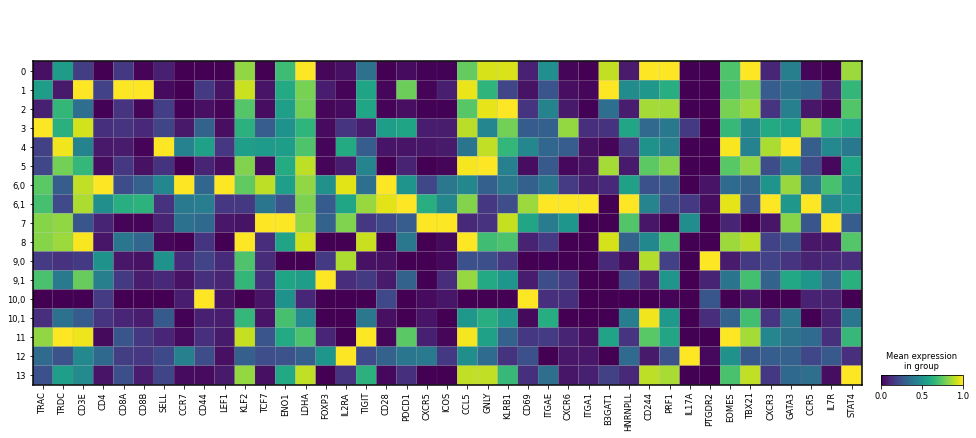

In [159]:
sc.pl.matrixplot(rna_x,faber,groupby = 'leiden_R2.2',standard_scale ='var')

In [162]:
CD8NK = ['CD3E',
       'CD8B',
         'SELL',
         'CCR7',
       'TRDV1',
       'TRDV2',
       'TRDV3',
       'TYROBP',
       'KLRC2',
         'FCGR3A',
       'NCAM1',
       'GZMA',
       'GZMB',
       'GZMK',
       'CD69',
       'ITGAE',
       'ITGA1',
         'GATA3',
         'KIT',
         'RORC',
        'GATA2',
        'FCER1A',
        'IL3RA']

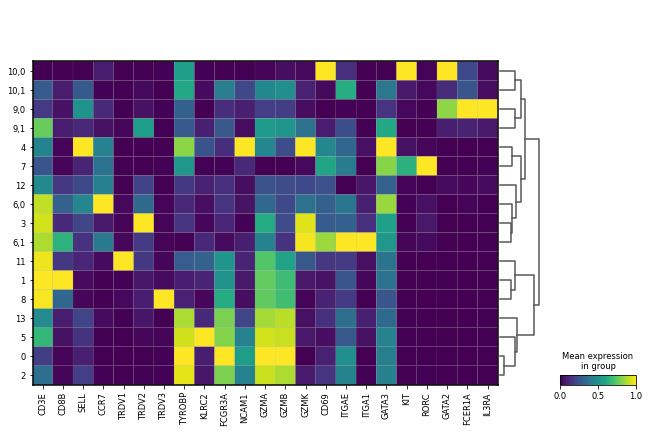

In [163]:
sc.pl.matrixplot(rna_x,CD8NK,groupby = 'leiden_R2.2',dendrogram = True,standard_scale = 'var')

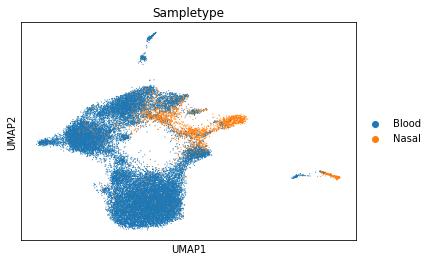

In [170]:
sc.pl.umap(rna_x, color=[ 'Sampletype'], legend_fontoutline=2)

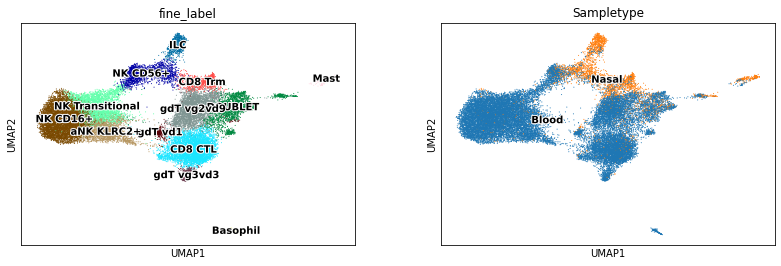

In [317]:
sc.pl.umap(rna_x, color=['fine_label', 'Sampletype'], legend_loc='on data', legend_fontoutline=2)

... storing 'subset_annotations' as categorical


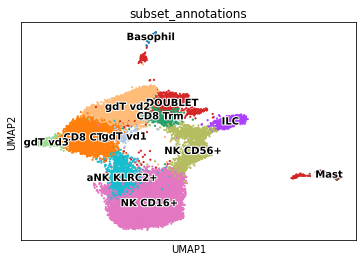

In [165]:
new_dict1 = {'0':'NK CD16+',
            '1':'CD8 CTL',
            '2':'NK CD16+',
            '3':'gdT vd2',
            '4':'NK CD56+',
            '5':'aNK KLRC2+',
            '6,0':'DOUBLET',
            '6,1':'CD8 Trm',
            '7':'ILC',
            '8':'gdT vd3',
            '9,0':'Basophil',
            '9,1':'DOUBLET',
            '10,0':'Mast',
            '10,1':'DOUBLET',
            '11':'gdT vd1',
            '12':'DOUBLET',
            '13':'NK CD16+'}
rna_x.obs['subset_annotations'] = [new_dict1[l] for l in rna_x.obs['leiden_R2.2']]
sc.pl.umap(rna_x, color=['subset_annotations'], size=20, legend_loc ='on data', legend_fontoutline=2)

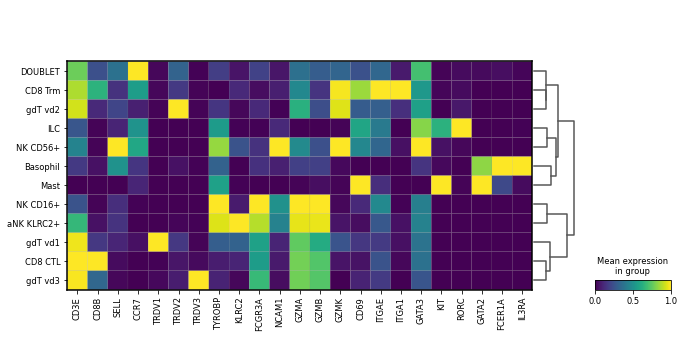

In [168]:
sc.pl.matrixplot(rna_x,CD8NK,groupby = 'subset_annotations',dendrogram = True,standard_scale = 'var')

... storing 'subset_annotations' as categorical


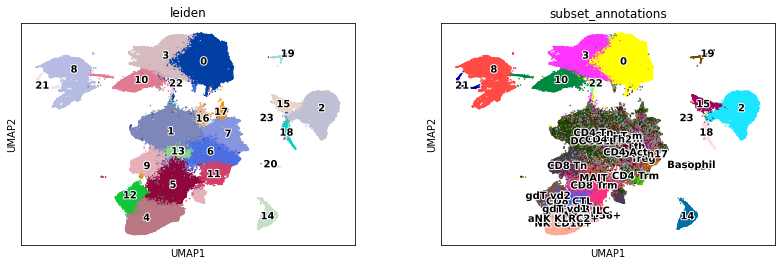

In [171]:
# update the original object
adata.obs['subset_annotations'] = adata.obs['subset_annotations'].astype('object')
adata.obs['subset_annotations'].update(rna_x.obs['subset_annotations'].astype('object'))
sc.pl.umap(adata, color = ['leiden', 'subset_annotations'], size = 10, legend_loc = 'on data', legend_fontoutline=2)

In [320]:
#save for now
adata.write('COV_nd_TNK_fine_label_100721.h5ad', compression = 'gzip')
adata.raw.to_adata().write('COV_nd_TNK_fine_label_raw_100721.h5ad', compression = 'gzip')

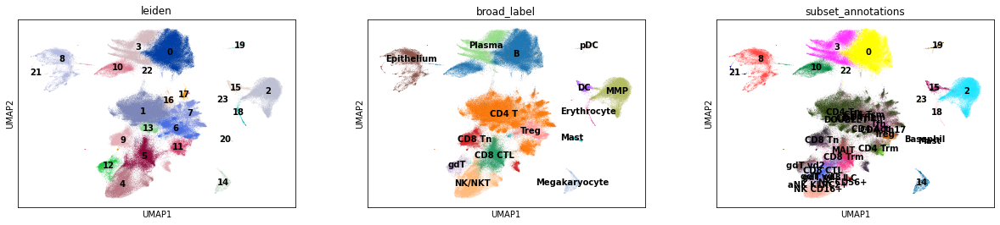

In [172]:
sc.pl.umap(adata, color=['leiden','broad_label','subset_annotations'], legend_loc = 'on data')

In [382]:
#save for now
adata.write('COV_nd2_TNK_fine_label_110721.h5ad', compression = 'gzip')
adata.raw.to_adata().write('COV_nd2_TNK_fine_label_raw_110721.h5ad', compression = 'gzip')

### B cells

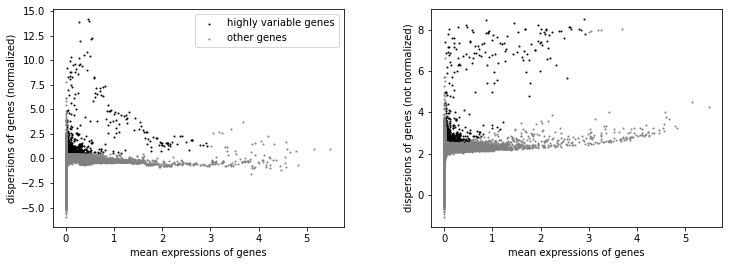

AnnData object with n_obs × n_vars = 86344 × 25675
    obs: 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'doublet_score', 'predicted_doublet', 'Sampleid', 'Patient', 'Sampletype', 'Age_group', 'Gender', 'Cohort', 'Diseasetype', 'Batch', 'Study', 'Nasal_inflammation', 'COVID_severity', 'sampleid', 'soup_correction', 'scrublet_score', 'n_genes', 'is_doublet', 'filter_rna', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'celltypist', 'combined_doublet', 'cellbender_cell', 'leiden', 'broad_label', 'fine_label', 'moderate-severe', 'subset_annotation', 'subset_annotations'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'hvg', 'pca', 'neighbors', 'umap', 'Sampleid_colors', 'Patient_colors', 'Sampletype_colors', 'leiden', 'leiden_colors', 'Gender_colors', 'Cohort_colors', 'r

In [335]:
# subset
rna_ = adata[adata.obs['leiden'].isin(['0', '3', '10','22'])]
rna_x = sc.AnnData(X = rna_.raw.X, obs = rna_.obs, var = rna_.raw.var, uns = rna_.uns, obsm = rna_.obsm, obsp = rna_.obsp)
rna_x.raw = rna_x
sc.pp.highly_variable_genes(rna_x, min_mean = 0.0125, max_mean = 3, min_disp = 0.5)
sc.pl.highly_variable_genes(rna_x)
rna_x

In [336]:
rna_x.obs['subset_annotations'].value_counts()

Bmem switched        49779
DOUBLET              11334
Plasmablast IgM+      6535
B FO                  6183
Plasma                6150
Bmem non-switched     5359
B Naive               1004
Name: subset_annotations, dtype: int64

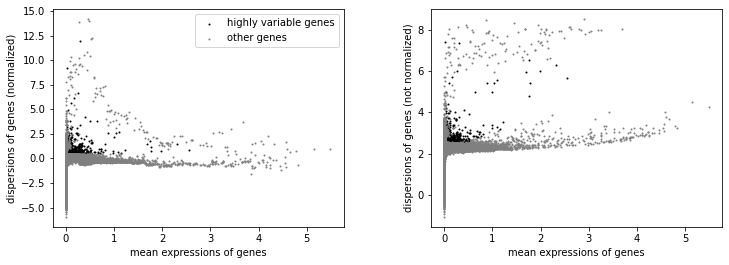

In [174]:
## remove TRBV/TRAV and IGHV/IGLV/IGKV from the highly variable genes
import re
for i in rna_x.var.index:
    if re.search('^TR[AB]V|^IG[HKL]V', i):
        rna_x.var.at[i, 'highly_variable'] = False
sc.pl.highly_variable_genes(rna_x)

In [175]:
# subset to highly variable
rna_x = rna_x[:, rna_x.var['highly_variable']]
# regress and scale for PCA
sc.pp.regress_out(rna_x, ['total_counts', 'pct_counts_mt'])
sc.pp.scale(rna_x, max_value = 10)

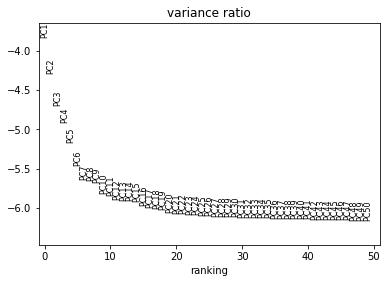

In [176]:
# Principal component analysis
sc.tl.pca(rna_x, svd_solver = 'arpack')
sc.pl.pca_variance_ratio(rna_x, log = True, n_pcs = 50)

In [177]:
# Computing the neighborhood graph. Seurat uses k = 20 as default
sc.pp.neighbors(rna_x, n_neighbors = 10, n_pcs = 50)

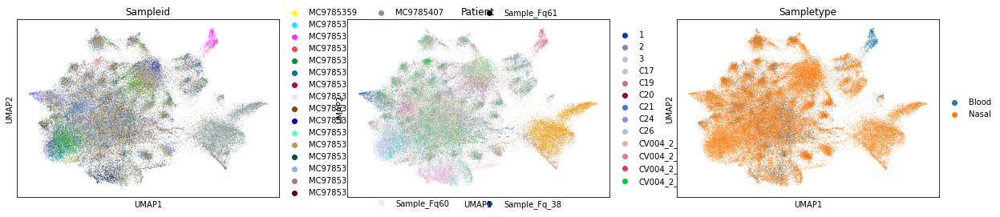

In [178]:
# run UMAP
sc.tl.umap(rna_x, n_components = 2, min_dist = 0.3)
sc.pl.umap(rna_x, color=['Sampleid','Patient', 'Sampletype'])

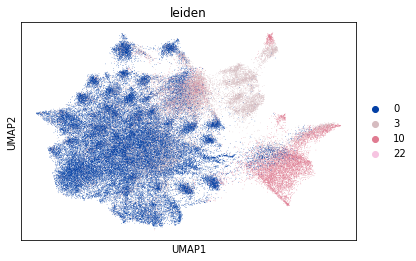

In [179]:
sc.pl.umap(rna_x, color=['leiden'])

In [180]:
# run harmony
sc.external.pp.harmony_integrate(rna_x, 'Patient')
'X_pca_harmony' in rna_x.obsm


2021-07-12 11:54:48,757 - harmonypy - INFO - Iteration 1 of 10
2021-07-12 11:56:07,245 - harmonypy - INFO - Iteration 2 of 10
2021-07-12 11:57:27,650 - harmonypy - INFO - Iteration 3 of 10
2021-07-12 11:58:46,229 - harmonypy - INFO - Converged after 3 iterations


True

In [181]:
rna_x

AnnData object with n_obs × n_vars = 86344 × 900
    obs: 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'doublet_score', 'predicted_doublet', 'Sampleid', 'Patient', 'Sampletype', 'Age_group', 'Gender', 'Cohort', 'Diseasetype', 'Batch', 'Study', 'Nasal_inflammation', 'COVID_severity', 'sampleid', 'soup_correction', 'scrublet_score', 'n_genes', 'is_doublet', 'filter_rna', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'celltypist', 'combined_doublet', 'cellbender_cell', 'leiden', 'broad_label', 'fine_label', 'moderate-severe', 'subset_annotation', 'subset_annotations'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'pca', 'neighbors', 'umap', 'Sampleid_colors', 'Patient_colors', 'Sampletype_colors', 'leiden', 'leiden_colors', 'Gender_colors', 'Cohor

In [182]:
# Computing the neighborhood graph. Seurat uses k = 20 as default
sc.pp.neighbors(rna_x, n_neighbors = 10, n_pcs = 50, use_rep='X_pca_harmony')

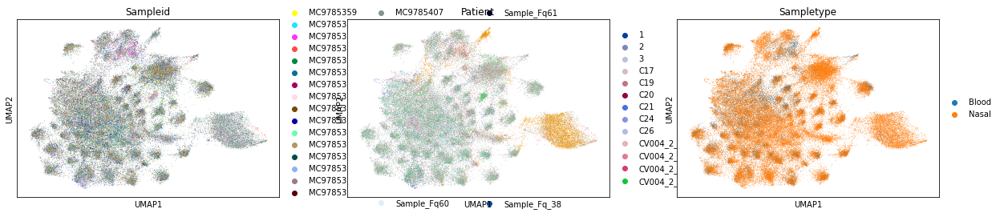

In [183]:
# UMAP
sc.tl.umap(rna_x, n_components = 2, min_dist = 0.3)
sc.pl.umap(rna_x, color=['Sampleid','Patient', 'Sampletype'])

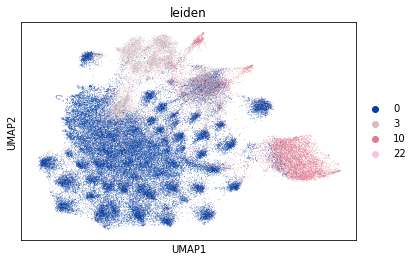

In [184]:
sc.pl.umap(rna_x, color=['leiden'])

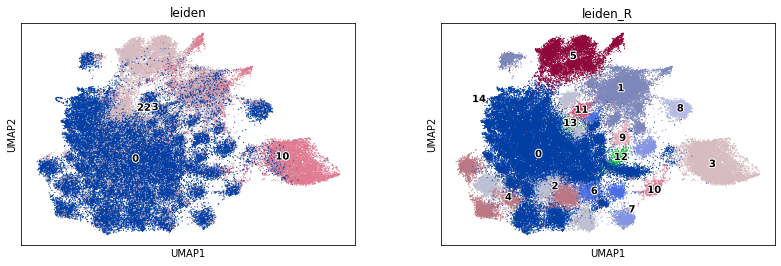

In [207]:
# find clusters
sc.tl.leiden(rna_x, resolution = 0.3, key_added = 'leiden_R')
sc.pl.umap(rna_x, color=['leiden', 'leiden_R'], size=6, legend_loc ='on data', legend_fontoutline=2)

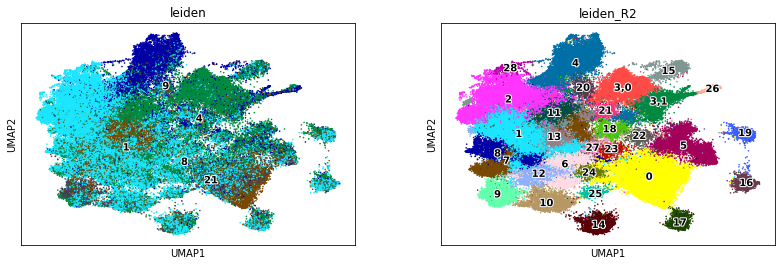

In [241]:
# split clusters
#sc.tl.leiden(rna_x, resolution = .2, key_added = 'leiden_R2', restrict_to = ('leiden_R', ['3']))
#sc.pl.umap(rna_x, color=['leiden', 'leiden_R2'], size=10, legend_loc ='on data', legend_fontoutline=2)

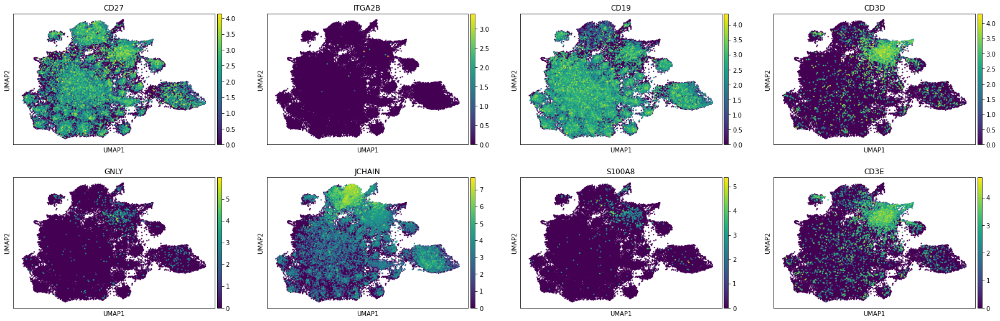

In [189]:
sc.pl.umap(rna_x, color = ['CD27', 'ITGA2B', 'CD19', 'CD3D', 'GNLY', 'JCHAIN', 'S100A8', 'CD3E'], size = 20)

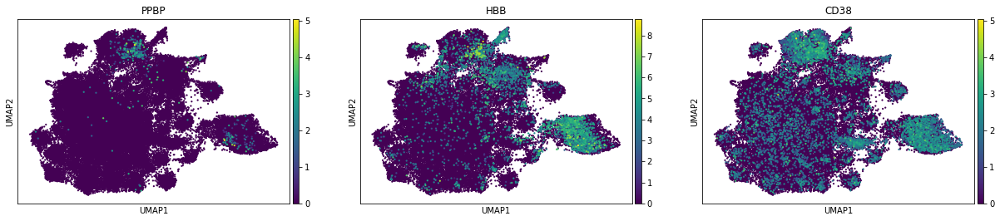

In [190]:
sc.pl.umap(rna_x, color = ['PPBP', 'HBB','CD38'], size = 20)

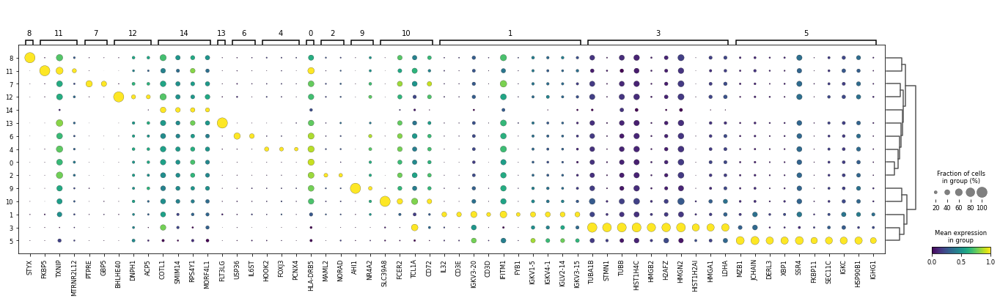

In [208]:
sc.tl.rank_genes_groups(rna_x, groupby = 'leiden_R', method = 'wilcoxon')
sc.tl.filter_rank_genes_groups(rna_x, min_fold_change=1)
sc.tl.dendrogram(rna_x, groupby = 'leiden_R')
sc.pl.rank_genes_groups_dotplot(rna_x, n_genes = 10, standard_scale = 'var', color_map = 'viridis', key = 'rank_genes_groups_filtered')

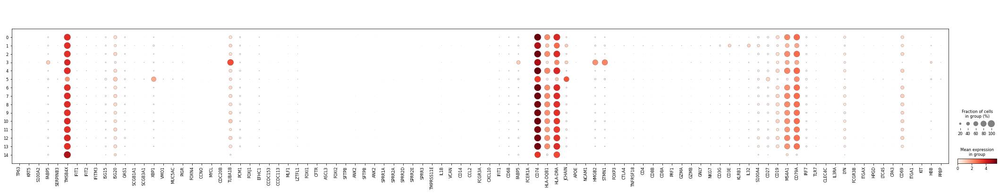

In [209]:
#Plotting Chau et al Nat Biotech 2020 cell marker genes by cluster(nasal brushing COVID paper)
sc.pl.dotplot(rna_x, Chuafeat, groupby = 'leiden_R')

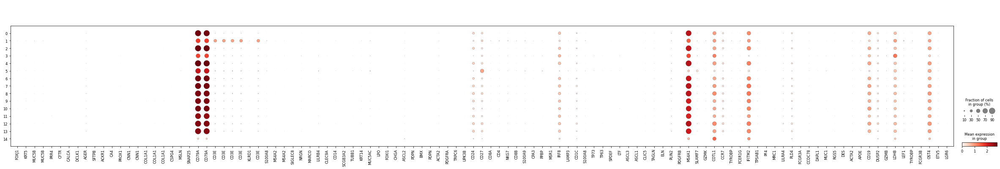

In [210]:
#Plotting Travaglini 2020 Nature cell markergene by cluster (lung paper)
sc.pl.dotplot(rna_x, Trav_list, groupby = 'leiden_R')

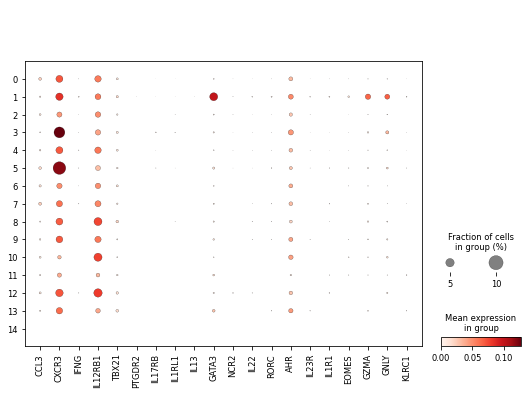

In [211]:
#Plotting ILC marker geneset from Bjorkland 2016 by cluster
sc.pl.dotplot(rna_x, ILC_Bjorkland, groupby = 'leiden_R')

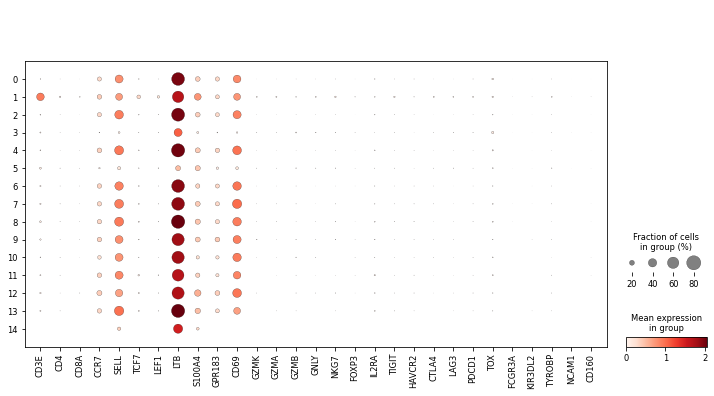

In [212]:
#Plotting Zhang 2020 T cell subset marker genes by cluster 
sc.pl.dotplot(rna_x, Zhang2020_T, groupby = 'leiden_R')

In [200]:
#Selection of key B cell subset markers
Bmark = ['CD19', 'MS4A1','CD38','JCHAIN','MME','CD27','IGHD','IGHM','IGHE','IGHA1','IGHG1','TNFRSF13C', 'TNFRSF13B',
         'TNFRSF17','CR2','CD5','FCER2','CD24', 'HLA-DRA', 'CD79A',
        'CXCR4','CXCR5','CD34','CD86','CD1D','CD74', 'CD40']
Bmark

['CD19',
 'MS4A1',
 'CD38',
 'JCHAIN',
 'MME',
 'CD27',
 'IGHD',
 'IGHM',
 'IGHE',
 'IGHA1',
 'IGHG1',
 'TNFRSF13C',
 'TNFRSF13B',
 'TNFRSF17',
 'CR2',
 'CD5',
 'FCER2',
 'CD24',
 'HLA-DRA',
 'CD79A',
 'CXCR4',
 'CXCR5',
 'CD34',
 'CD86',
 'CD1D',
 'CD74',
 'CD40']

In [204]:
Bmarkshort = ['CD19', 'MS4A1','CD38','JCHAIN','MME','CD27','IGHD','IGHM','IGHE','IGHA1','IGHG1', 'HLA-DRA',
        'CXCR4','CXCR5','CD1D']
Bmarkshort

['CD19',
 'MS4A1',
 'CD38',
 'JCHAIN',
 'MME',
 'CD27',
 'IGHD',
 'IGHM',
 'IGHE',
 'IGHA1',
 'IGHG1',
 'HLA-DRA',
 'CXCR4',
 'CXCR5',
 'CD1D']

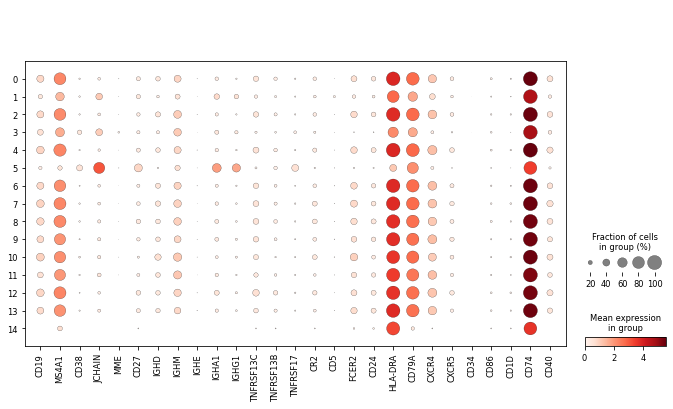

In [216]:
sc.pl.dotplot(rna_x,Bmark,groupby='leiden_R')

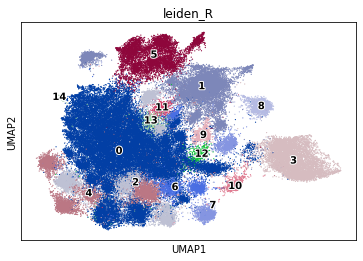

In [217]:
sc.pl.umap(rna_x, color=['leiden_R'], size=6, legend_loc ='on data', legend_fontoutline=2)

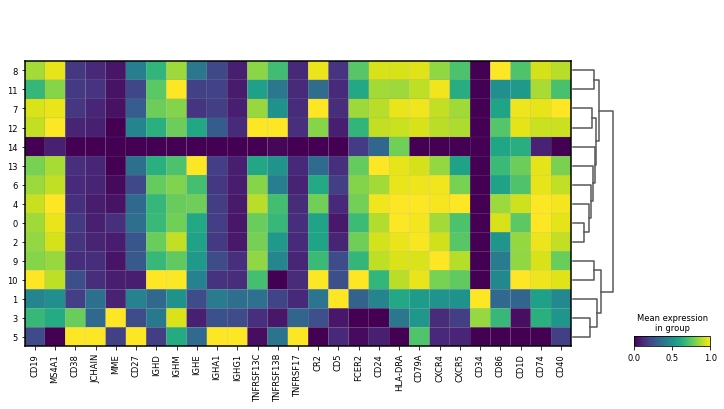

In [214]:
sc.pl.matrixplot(rna_x,Bmark,groupby='leiden_R', standard_scale='var', dendrogram = True)

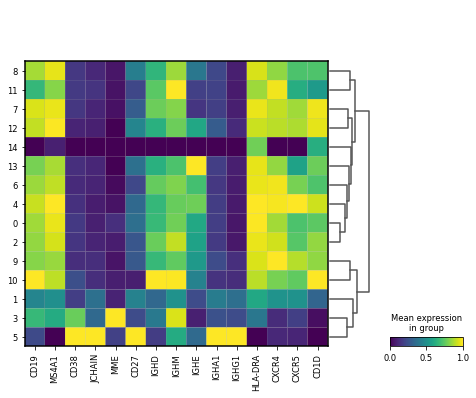

In [215]:
sc.pl.matrixplot(rna_x,Bmarkshort,groupby='leiden_R', standard_scale='var', dendrogram = True)

... storing 'subset_annotations' as categorical


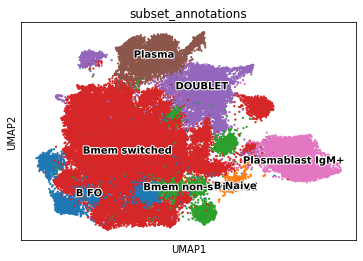

In [218]:
new_dict1 = {'0':'Bmem switched',
             '1':'DOUBLET',
             '2':'Bmem switched',
             '3':'Plasmablast IgM+',
             '4':'B FO',
             '5':'Plasma',
             '6':'Bmem non-switched',
             '7':'Bmem non-switched',
             '8':'Bmem switched',
             '9':'Bmem switched',
             '10':'B Naive',
             '11':'Bmem switched',
             '12':'Bmem switched',
             '13':'Bmem switched',
             '14':'DOUBLET'
             
             
             
             
             
}
rna_x.obs['subset_annotations'] = [new_dict1[l] for l in rna_x.obs['leiden_R']]
sc.pl.umap(rna_x, color=['subset_annotations'], size=20, legend_loc ='on data', legend_fontoutline=2)

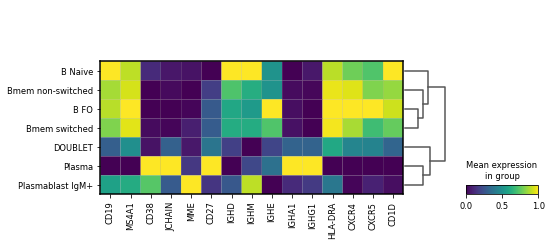

In [219]:
sc.pl.matrixplot(rna_x,Bmarkshort,groupby='subset_annotations', standard_scale='var', dendrogram = True)

... storing 'subset_annotations' as categorical


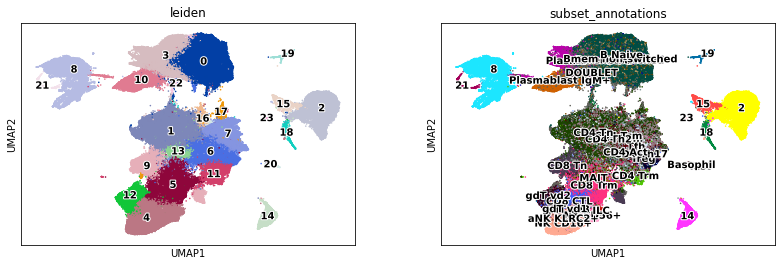

In [223]:
# update the original object
adata.obs['subset_annotations'] = adata.obs['subset_annotations'].astype('object')
adata.obs['subset_annotations'].update(rna_x.obs['subset_annotations'].astype('object'))
sc.pl.umap(adata, color = ['leiden', 'subset_annotations'], size = 10, legend_loc = 'on data', legend_fontoutline=2)

In [285]:
#save for now
adata_concat.write('COV_combined_TNKB-fine_label_060721.h5ad', compression = 'gzip')
adata_concat.raw.to_adata().write('COV_combined_TNKB_fine_label_raw_060721.h5ad', compression = 'gzip')

In [7]:
#load as kernel died
adata_concat = sc.read_h5ad('COV_combined_TNKB-fine_label_060721.h5ad')
adata_concat

AnnData object with n_obs × n_vars = 456439 × 1329
    obs: 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'doublet_score', 'predicted_doublet', 'Sampleid', 'Patient', 'Sampletype', 'Age_group', 'Gender', 'Cohort', 'Diseasetype', 'Batch', 'Study', 'Nasal_inflammation', 'COVID_severity', 'sampleid', 'soup_correction', 'scrublet_score', 'n_genes', 'is_doublet', 'filter_rna', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'celltypist', 'combined_doublet', 'cellbender_cell', 'leiden', 'broad_label', 'fine_label'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'Cohort_colors', 'Gender_colors', 'Patient_colors', 'Sampleid_colors', 'Sampletype_colors', 'broad_label_colors', 'celltypist_colors', 'dendrogram_leiden', 'fine_label_colors', 'hvg', 'leiden', 'leiden_c

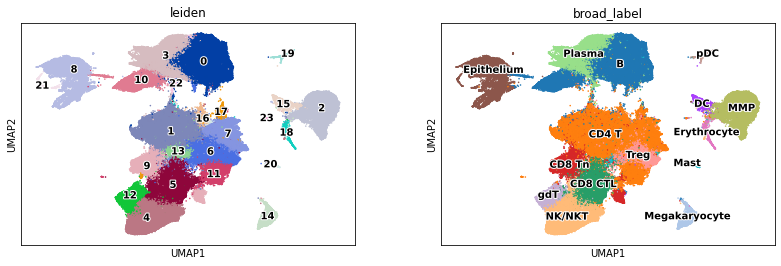

In [224]:
sc.pl.umap(adata, color = ['leiden', 'broad_label'], size = 10, legend_loc = 'on data', legend_fontoutline=2)

### monocyte/macrophage/DC/pDC

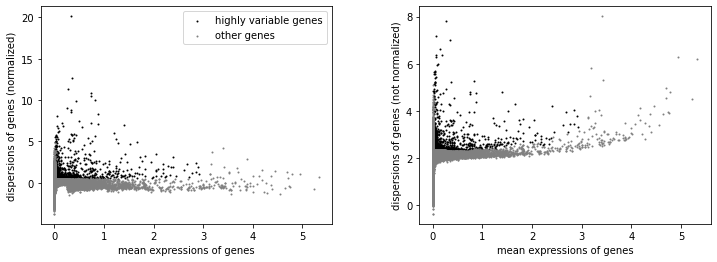

AnnData object with n_obs × n_vars = 26763 × 25675
    obs: 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'doublet_score', 'predicted_doublet', 'Sampleid', 'Patient', 'Sampletype', 'Age_group', 'Gender', 'Cohort', 'Diseasetype', 'Batch', 'Study', 'Nasal_inflammation', 'COVID_severity', 'sampleid', 'soup_correction', 'scrublet_score', 'n_genes', 'is_doublet', 'filter_rna', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'celltypist', 'combined_doublet', 'cellbender_cell', 'leiden', 'broad_label', 'fine_label', 'moderate-severe', 'subset_annotation', 'subset_annotations'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'hvg', 'pca', 'neighbors', 'umap', 'Sampleid_colors', 'Patient_colors', 'Sampletype_colors', 'leiden', 'leiden_colors', 'Gender_colors', 'Cohort_colors', 'r

In [333]:
# subset
rna_ = adata[adata.obs['leiden'].isin(['2','15','19'])]
rna_x = sc.AnnData(X = rna_.raw.X, obs = rna_.obs, var = rna_.raw.var, uns = rna_.uns, obsm = rna_.obsm, obsp = rna_.obsp)
rna_x.raw = rna_x
sc.pp.highly_variable_genes(rna_x, min_mean = 0.0125, max_mean = 3, min_disp = 0.5)
sc.pl.highly_variable_genes(rna_x)
rna_x

In [334]:
rna_x.obs['subset_annotations'].value_counts()

Monocyte classical         19308
Monocyte non-classical      2477
DOUBLET                     1596
cDC CD1c+                   1414
pDC                          987
Macrophage resident          498
Macrophage non-resident      304
cDC CD141+                   179
Name: subset_annotations, dtype: int64

In [227]:
# subset to highly variable
rna_x = rna_x[:, rna_x.var['highly_variable']]
# regress and scale for PCA
sc.pp.regress_out(rna_x, ['total_counts', 'pct_counts_mt'])
sc.pp.scale(rna_x, max_value = 10)

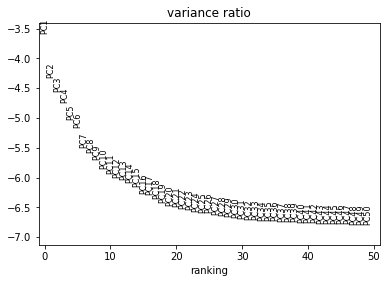

In [228]:
# Principal component analysis
sc.tl.pca(rna_x, svd_solver = 'arpack')
sc.pl.pca_variance_ratio(rna_x, log = True, n_pcs = 50)

In [229]:
# Computing the neighborhood graph. Seurat uses k = 20 as default
sc.pp.neighbors(rna_x, n_neighbors = 10, n_pcs = 50)

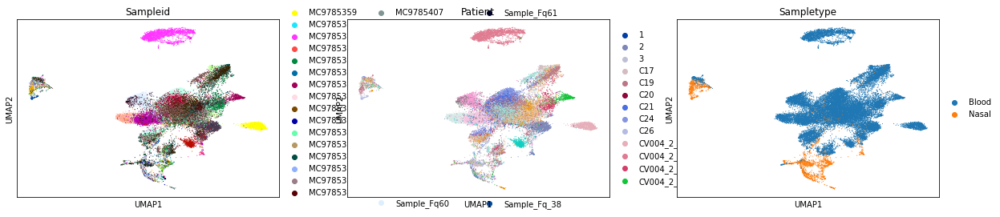

In [230]:
# run UMAP
sc.tl.umap(rna_x, n_components = 2, min_dist = 0.3)
sc.pl.umap(rna_x, color=['Sampleid','Patient', 'Sampletype'])

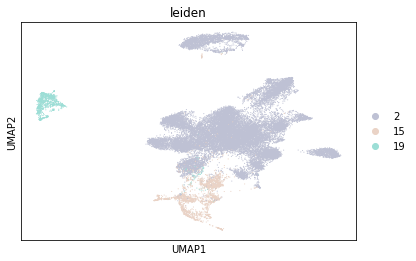

In [231]:
sc.pl.umap(rna_x, color=['leiden'])

In [232]:
# run harmony
sc.external.pp.harmony_integrate(rna_x, 'Patient')
'X_pca_harmony' in rna_x.obsm


2021-07-12 13:42:46,051 - harmonypy - INFO - Iteration 1 of 10
2021-07-12 13:43:15,947 - harmonypy - INFO - Iteration 2 of 10
2021-07-12 13:43:45,534 - harmonypy - INFO - Converged after 2 iterations


True

In [233]:
rna_x

AnnData object with n_obs × n_vars = 26763 × 1656
    obs: 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'doublet_score', 'predicted_doublet', 'Sampleid', 'Patient', 'Sampletype', 'Age_group', 'Gender', 'Cohort', 'Diseasetype', 'Batch', 'Study', 'Nasal_inflammation', 'COVID_severity', 'sampleid', 'soup_correction', 'scrublet_score', 'n_genes', 'is_doublet', 'filter_rna', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'celltypist', 'combined_doublet', 'cellbender_cell', 'leiden', 'broad_label', 'fine_label', 'moderate-severe', 'subset_annotation', 'subset_annotations'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'pca', 'neighbors', 'umap', 'Sampleid_colors', 'Patient_colors', 'Sampletype_colors', 'leiden', 'leiden_colors', 'Gender_colors', 'Coho

In [234]:
# Computing the neighborhood graph. Seurat uses k = 20 as default
sc.pp.neighbors(rna_x, n_neighbors = 10, n_pcs = 50, use_rep='X_pca_harmony')

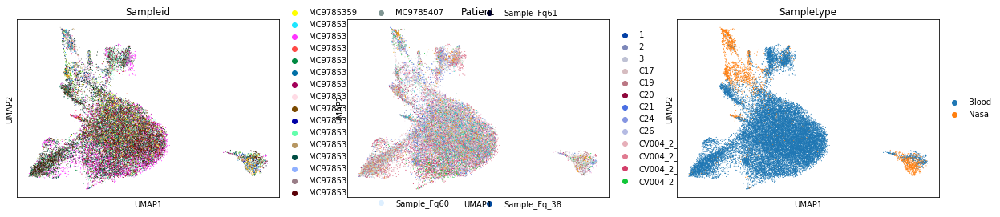

In [235]:
# UMAP
sc.tl.umap(rna_x, n_components = 2, min_dist = 0.3)
sc.pl.umap(rna_x, color=['Sampleid','Patient', 'Sampletype'])

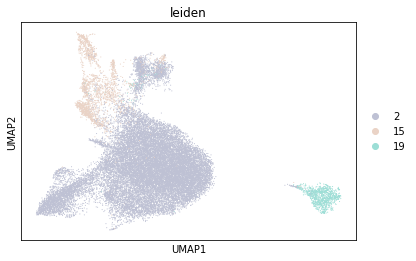

In [236]:
sc.pl.umap(rna_x, color=['leiden'])

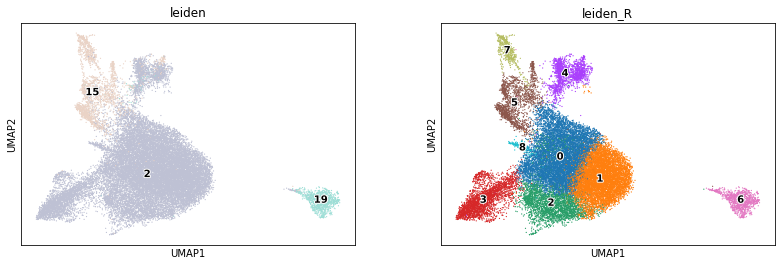

In [239]:
# find clusters
sc.tl.leiden(rna_x, resolution = 0.5, key_added = 'leiden_R')
sc.pl.umap(rna_x, color=['leiden', 'leiden_R'], size=6, legend_loc ='on data', legend_fontoutline=2)

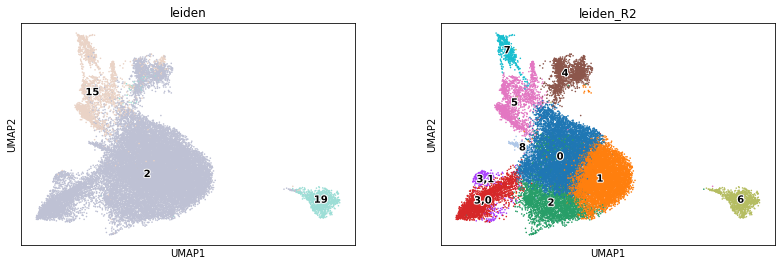

In [252]:
# split clusters
sc.tl.leiden(rna_x, resolution = .2, key_added = 'leiden_R2', restrict_to = ('leiden_R', ['3']))
sc.pl.umap(rna_x, color=['leiden', 'leiden_R2'], size=10, legend_loc ='on data', legend_fontoutline=2)

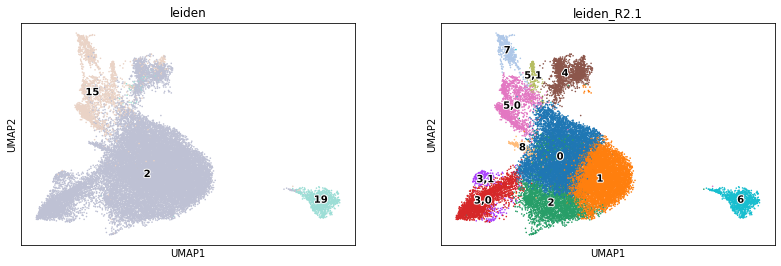

In [254]:
# split clusters
sc.tl.leiden(rna_x, resolution = .1, key_added = 'leiden_R2.1', restrict_to = ('leiden_R2', ['5']))
sc.pl.umap(rna_x, color=['leiden', 'leiden_R2.1'], size=10, legend_loc ='on data', legend_fontoutline=2)

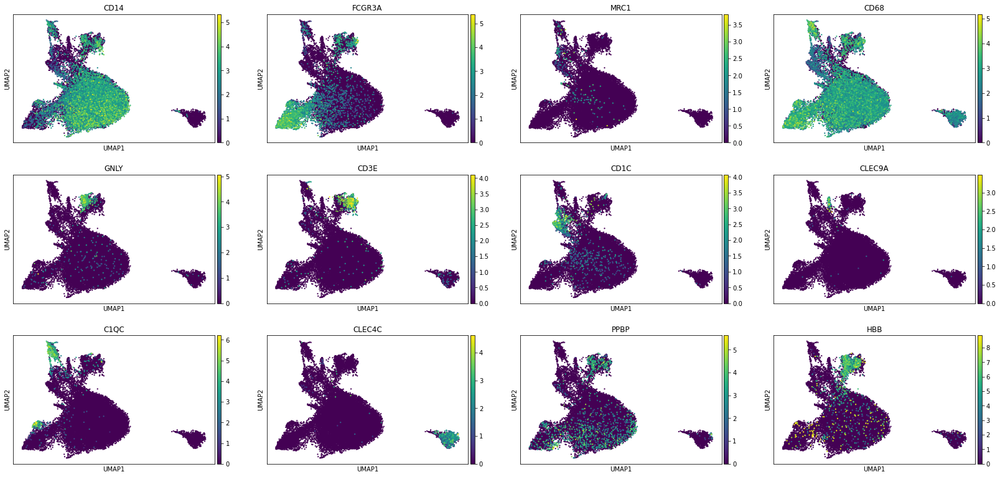

In [261]:
sc.pl.umap(rna_x, color = ['CD14', 'FCGR3A', 'MRC1', 'CD68', 'GNLY', 'CD3E', 'CD1C', 'CLEC9A', 'C1QC', 'CLEC4C', 'PPBP', 'HBB'], size = 20)

categories: 0, 1, 2, etc.
var_group_labels: 1, 2, 3,0, etc.


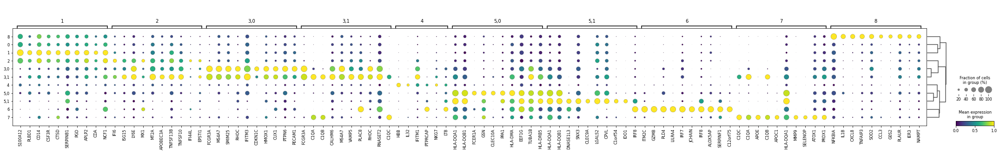

In [255]:
sc.tl.rank_genes_groups(rna_x, groupby = 'leiden_R2.1', method = 'wilcoxon')
sc.tl.filter_rank_genes_groups(rna_x, min_fold_change=1)
sc.tl.dendrogram(rna_x, groupby = 'leiden_R2.1')
sc.pl.rank_genes_groups_dotplot(rna_x, n_genes = 10, standard_scale = 'var', color_map = 'viridis', key = 'rank_genes_groups_filtered')

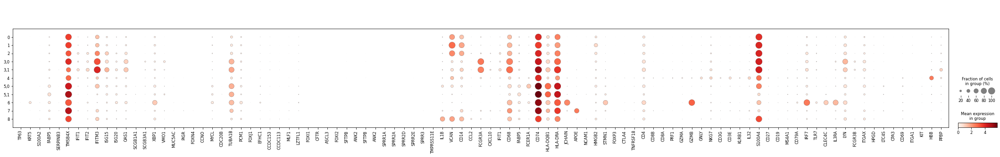

In [256]:
sc.pl.dotplot(rna_x, Chuafeat, groupby = 'leiden_R2.1')

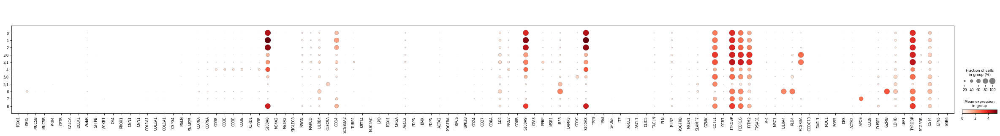

In [257]:
sc.pl.dotplot(rna_x, Trav_list, groupby = 'leiden_R2.1')

In [266]:
#A short list of MMP/DC markergenes for display purposes
MMPlist = ['CD14','FCGR3A','CD68','C1QC','APOE','LILRA4','CLEC4C','CLEC9A','CLEC10A']

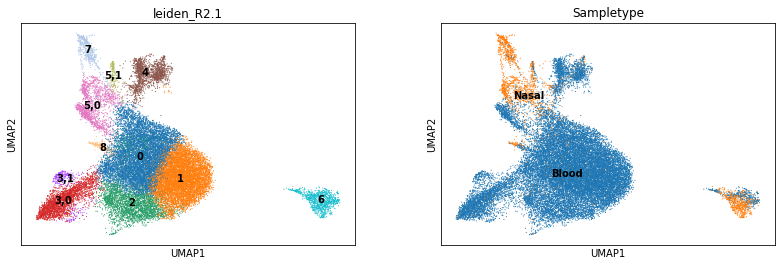

In [262]:
sc.pl.umap(rna_x, color = ['leiden_R2.1','Sampletype'], legend_loc = 'on data')

... storing 'subset_annotations' as categorical


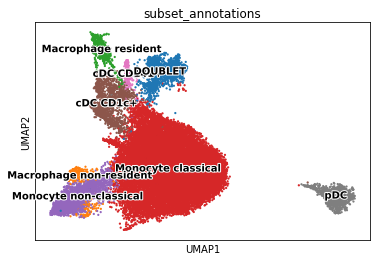

In [265]:
new_dict1 = {'0':'Monocyte classical',
             '1':'Monocyte classical',
             '2':'Monocyte classical',
             '3,0':'Monocyte non-classical',
             '3,1':'Macrophage non-resident',
             '4':'DOUBLET',
             '5,0':'cDC CD1c+',
             '5,1':'cDC CD141+',
             '6':'pDC',
             '7':'Macrophage resident',
             '8':'Monocyte classical'
}
rna_x.obs['subset_annotations'] = [new_dict1[l] for l in rna_x.obs['leiden_R2.1']]
sc.pl.umap(rna_x, color=['subset_annotations'], size=20, legend_loc ='on data', legend_fontoutline=2)

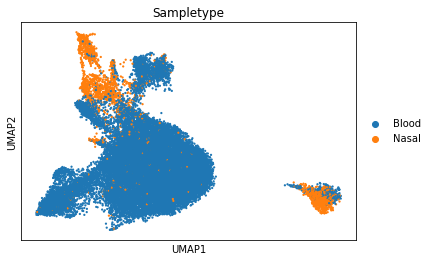

In [273]:
sc.pl.umap(rna_x, color=['Sampletype'], size=20, legend_fontoutline=2)

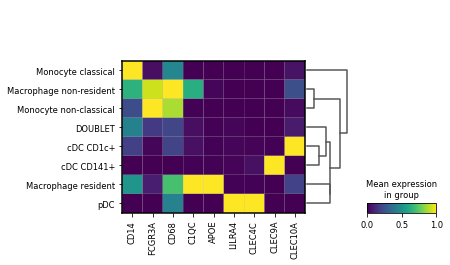

In [270]:
sc.pl.matrixplot(rna_x,MMPlist,groupby='subset_annotations', standard_scale='var', dendrogram = True)

... storing 'subset_annotations' as categorical


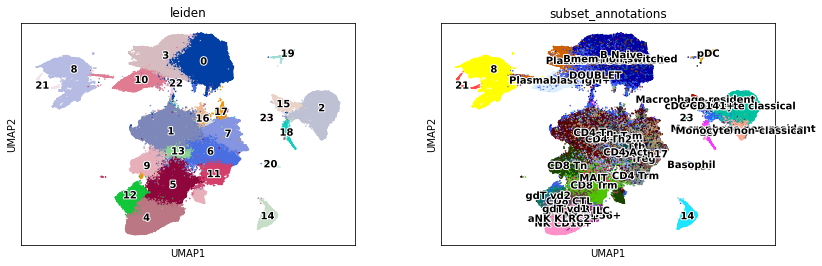

In [274]:
# update the original object
adata.obs['subset_annotations'] = adata.obs['subset_annotations'].astype('object')
adata.obs['subset_annotations'].update(rna_x.obs['subset_annotations'].astype('object'))
sc.pl.umap(adata, color = ['leiden', 'subset_annotations'], size = 10, legend_loc = 'on data', legend_fontoutline=2)

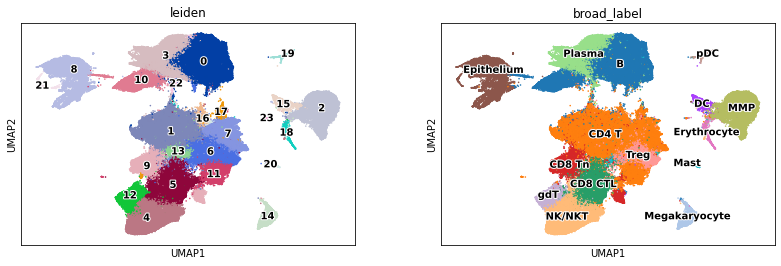

In [324]:
sc.pl.umap(adata, color = ['leiden', 'broad_label'], size = 10, legend_loc = 'on data', legend_fontoutline=2)

In [44]:
#save for now
adata_concat.write('COV_combined_TNKBMMP-fine_label_070721.h5ad', compression = 'gzip')
adata_concat.raw.to_adata().write('COV_combined_TNKBMMP_fine_label_raw_070721.h5ad', compression = 'gzip')

### Epithelial

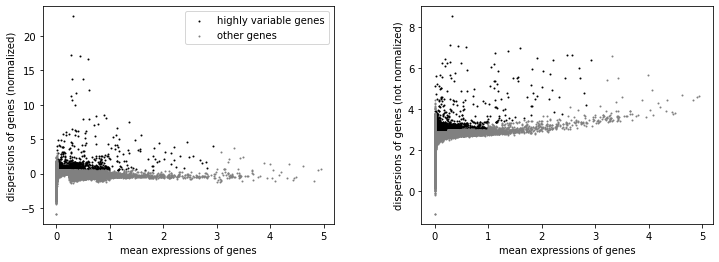

AnnData object with n_obs × n_vars = 14394 × 25675
    obs: 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'doublet_score', 'predicted_doublet', 'Sampleid', 'Patient', 'Sampletype', 'Age_group', 'Gender', 'Cohort', 'Diseasetype', 'Batch', 'Study', 'Nasal_inflammation', 'COVID_severity', 'sampleid', 'soup_correction', 'scrublet_score', 'n_genes', 'is_doublet', 'filter_rna', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'celltypist', 'combined_doublet', 'cellbender_cell', 'leiden', 'broad_label', 'fine_label', 'moderate-severe', 'subset_annotation', 'subset_annotations'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'hvg', 'pca', 'neighbors', 'umap', 'Sampleid_colors', 'Patient_colors', 'Sampletype_colors', 'leiden', 'leiden_colors', 'Gender_colors', 'Cohort_colors', 'r

In [325]:
# subset
rna_ = adata[adata.obs['leiden'].isin(['8','21'])]
rna_x = sc.AnnData(X = rna_.raw.X, obs = rna_.obs, var = rna_.raw.var, uns = rna_.uns, obsm = rna_.obsm, obsp = rna_.obsp)
rna_x.raw = rna_x
sc.pp.highly_variable_genes(rna_x, min_mean = 0.0125, max_mean = 3, min_disp = 0.5)
sc.pl.highly_variable_genes(rna_x)
rna_x

In [277]:
# subset to highly variable
rna_x = rna_x[:, rna_x.var['highly_variable']]
# regress and scale for PCA
sc.pp.regress_out(rna_x, ['total_counts', 'pct_counts_mt'])
sc.pp.scale(rna_x, max_value = 10)

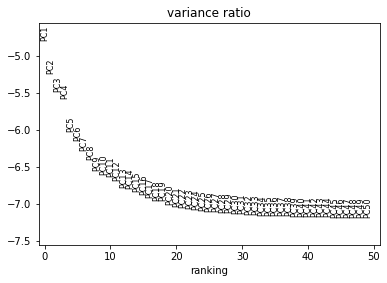

In [278]:
# Principal component analysis
sc.tl.pca(rna_x, svd_solver = 'arpack')
sc.pl.pca_variance_ratio(rna_x, log = True, n_pcs = 50)

In [279]:
# Computing the neighborhood graph. Seurat uses k = 20 as default
sc.pp.neighbors(rna_x, n_neighbors = 10, n_pcs = 50)

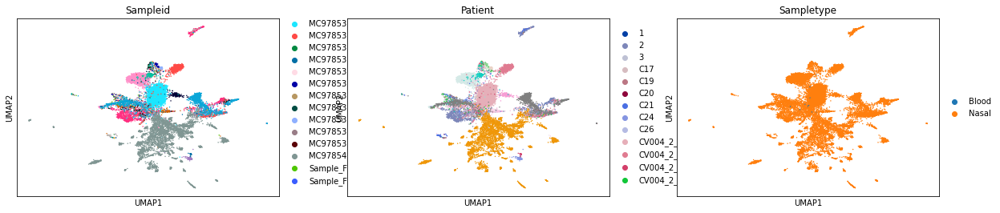

In [280]:
# run UMAP
sc.tl.umap(rna_x, n_components = 2, min_dist = 0.3)
sc.pl.umap(rna_x, color=['Sampleid','Patient', 'Sampletype'])

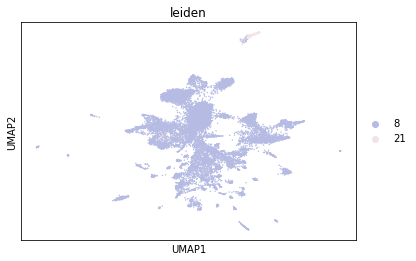

In [281]:
sc.pl.umap(rna_x, color=['leiden'])

In [282]:
# run harmony
sc.external.pp.harmony_integrate(rna_x, 'Patient')
'X_pca_harmony' in rna_x.obsm


2021-07-12 14:54:10,760 - harmonypy - INFO - Iteration 1 of 10
2021-07-12 14:54:21,225 - harmonypy - INFO - Iteration 2 of 10
2021-07-12 14:54:31,951 - harmonypy - INFO - Converged after 2 iterations


True

In [283]:
rna_x

AnnData object with n_obs × n_vars = 14394 × 3778
    obs: 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'doublet_score', 'predicted_doublet', 'Sampleid', 'Patient', 'Sampletype', 'Age_group', 'Gender', 'Cohort', 'Diseasetype', 'Batch', 'Study', 'Nasal_inflammation', 'COVID_severity', 'sampleid', 'soup_correction', 'scrublet_score', 'n_genes', 'is_doublet', 'filter_rna', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'celltypist', 'combined_doublet', 'cellbender_cell', 'leiden', 'broad_label', 'fine_label', 'moderate-severe', 'subset_annotation', 'subset_annotations'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'pca', 'neighbors', 'umap', 'Sampleid_colors', 'Patient_colors', 'Sampletype_colors', 'leiden', 'leiden_colors', 'Gender_colors', 'Coho

In [284]:
# Computing the neighborhood graph. Seurat uses k = 20 as default
sc.pp.neighbors(rna_x, n_neighbors = 10, n_pcs = 50, use_rep='X_pca_harmony')

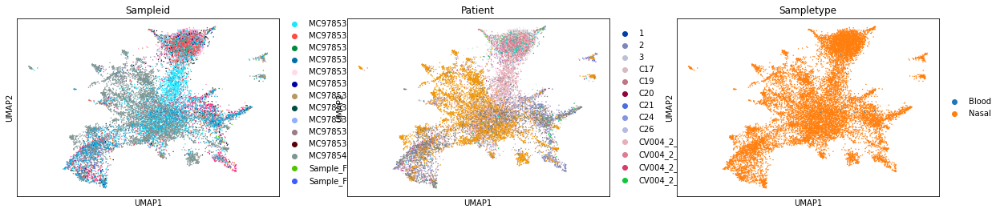

In [285]:
# UMAP
sc.tl.umap(rna_x, n_components = 2, min_dist = 0.3)
sc.pl.umap(rna_x, color=['Sampleid','Patient', 'Sampletype'])

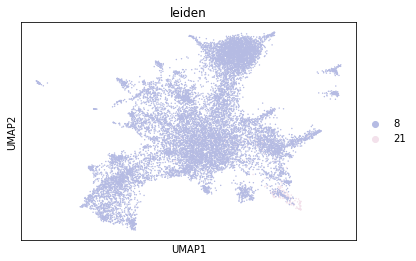

In [286]:
sc.pl.umap(rna_x, color=['leiden'])

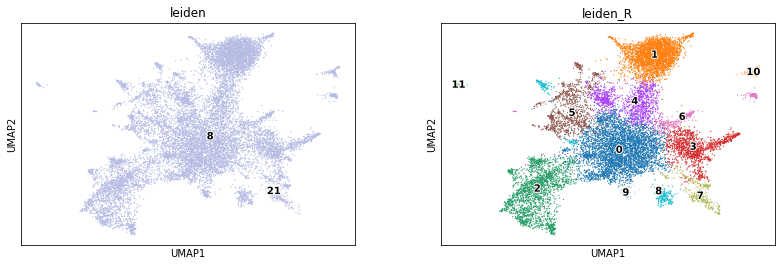

In [287]:
# find clusters
sc.tl.leiden(rna_x, resolution = 0.5, key_added = 'leiden_R')
sc.pl.umap(rna_x, color=['leiden', 'leiden_R'], size=6, legend_loc ='on data', legend_fontoutline=2)

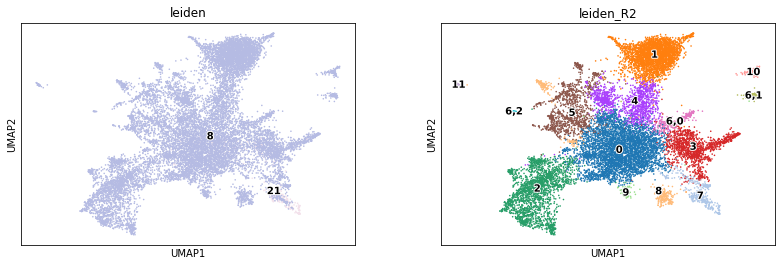

In [295]:
# split clusters
sc.tl.leiden(rna_x, resolution = .2, key_added = 'leiden_R2', restrict_to = ('leiden_R', ['6']))
sc.pl.umap(rna_x, color=['leiden', 'leiden_R2'], size=10, legend_loc ='on data', legend_fontoutline=2)

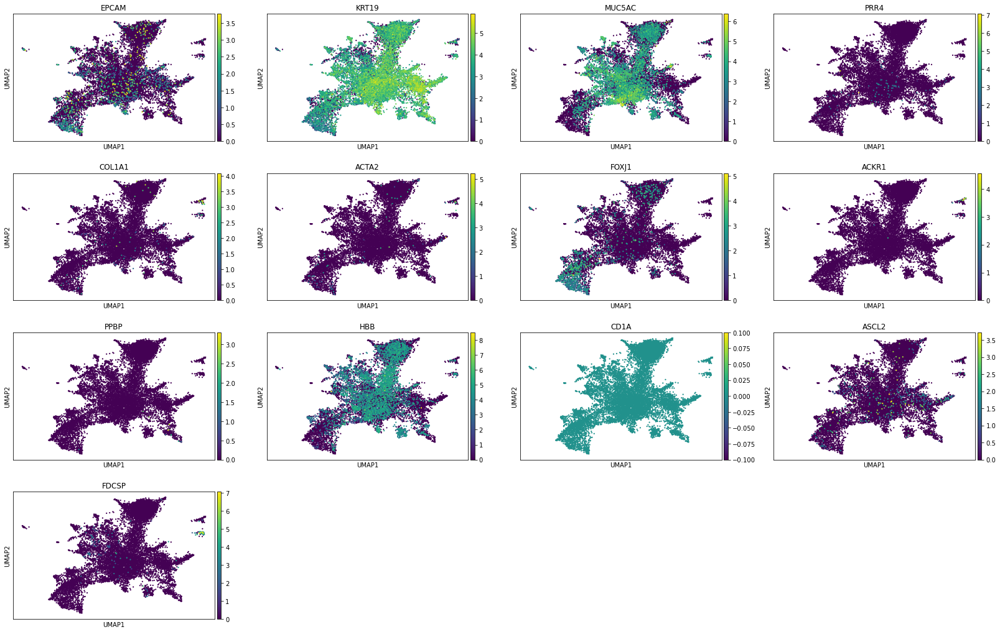

In [294]:
sc.pl.umap(rna_x, color = ['EPCAM','KRT19','MUC5AC','PRR4','COL1A1','ACTA2','FOXJ1','ACKR1','PPBP', 'HBB','CD1A','ASCL2','FDCSP'], size = 20)

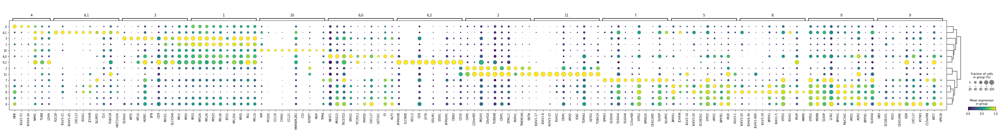

In [296]:
sc.tl.rank_genes_groups(rna_x, groupby = 'leiden_R2', method = 'wilcoxon')
sc.tl.filter_rank_genes_groups(rna_x, min_fold_change=1)
sc.tl.dendrogram(rna_x, groupby = 'leiden_R2')
sc.pl.rank_genes_groups_dotplot(rna_x, n_genes = 10, standard_scale = 'var', color_map = 'viridis', key = 'rank_genes_groups_filtered')

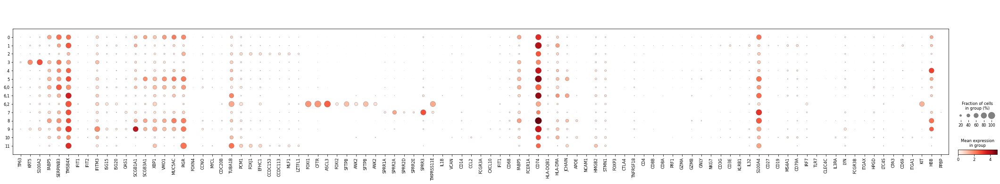

In [297]:
sc.pl.dotplot(rna_x, Chuafeat, groupby = 'leiden_R2')

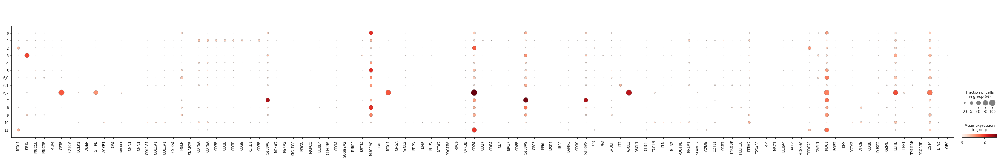

In [298]:
sc.pl.dotplot(rna_x, Trav_list, groupby = 'leiden_R2')

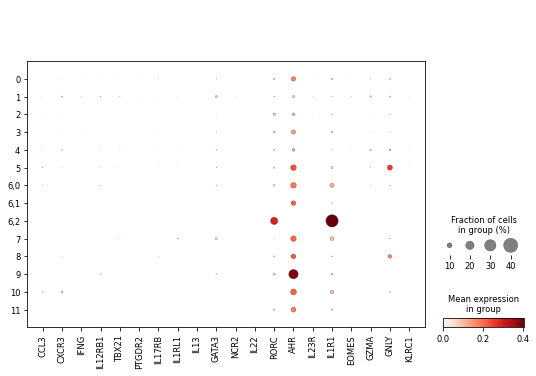

In [299]:
sc.pl.dotplot(rna_x, ILC_Bjorkland, groupby = 'leiden_R2')

In [329]:
#Short list of core Epithelial/stromal cell markers for display purposes. 
epimark = ['EPCAM','KRT5','KRT19','MUC5AC','FDCSP','FOXJ1','FOXI1','CFTR','ANK2','SPRR3','TMPRSS11E',
          'FCER1A', 'COL1A1','ACTA2','ACKR1']

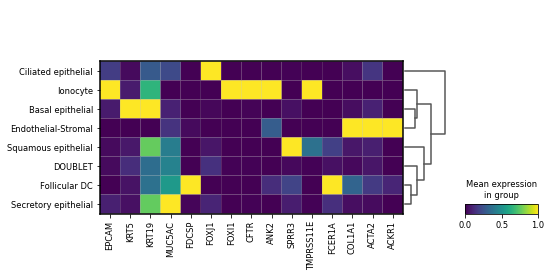

In [330]:
sc.pl.matrixplot(rna_x,epimark,groupby = 'subset_annotations',dendrogram = True,
                standard_scale = 'var')

In [332]:
rna_x.obs['subset_annotations'].value_counts()

Secretory epithelial    6062
DOUBLET                 4226
Ciliated epithelial     2239
Basal epithelial        1284
Squamous epithelial      376
Follicular DC            100
Endothelial-Stromal       95
Ionocyte                  12
Name: subset_annotations, dtype: int64

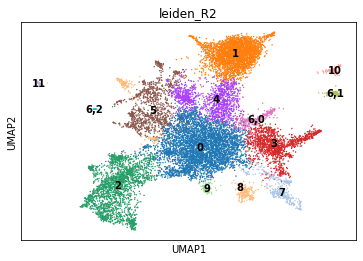

In [300]:
sc.pl.umap(rna_x, color = 'leiden_R2', legend_loc = 'on data')

... storing 'subset_annotations' as categorical


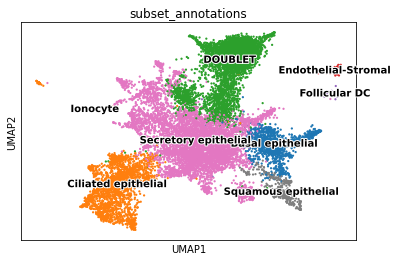

In [301]:
new_dict1 = {'0':'Secretory epithelial',
             '1':'DOUBLET',
             '2':'Ciliated epithelial',
             '3':'Basal epithelial',
             '4':'DOUBLET',
             '5':'Secretory epithelial',
             '6,0':'Secretory epithelial',
             '6,1':'Follicular DC',
             '6,2':'Ionocyte',
             '7':'Squamous epithelial',
             '8':'Secretory epithelial',
             '9':'Secretory epithelial',
             '10':'Endothelial-Stromal',
             '11':'Ciliated epithelial'
                         
}
rna_x.obs['subset_annotations'] = [new_dict1[l] for l in rna_x.obs['leiden_R2']]
sc.pl.umap(rna_x, color=['subset_annotations'], size=20, legend_loc ='on data', legend_fontoutline=2)

... storing 'subset_annotations' as categorical


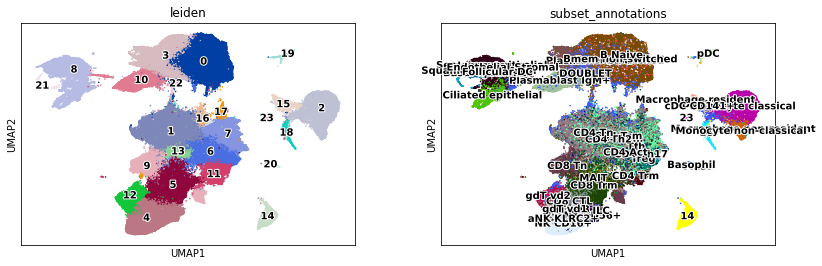

In [302]:
# update the original object
adata.obs['subset_annotations'] = adata.obs['subset_annotations'].astype('object')
adata.obs['subset_annotations'].update(rna_x.obs['subset_annotations'].astype('object'))
sc.pl.umap(adata, color = ['leiden', 'subset_annotations'], size = 10, legend_loc = 'on data', legend_fontoutline=2)

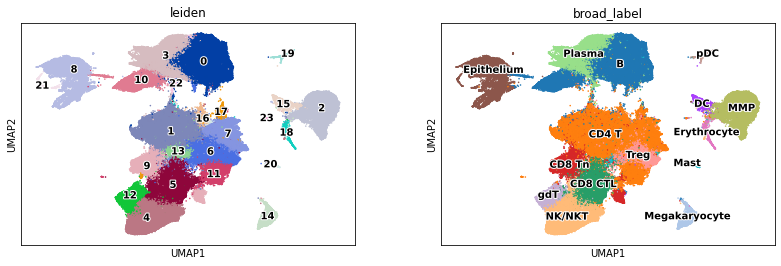

In [303]:
sc.pl.umap(adata, color = ['leiden', 'broad_label'], size = 10, legend_loc = 'on data', legend_fontoutline=2)

In [78]:
#save for now
adata_concat.write('COV_combined_TNKBMMPepi-fine_label_070721.h5ad', compression = 'gzip')
adata_concat.raw.to_adata().write('COV_combined_TNKBMMPepi_fine_label_raw_070721.h5ad', compression = 'gzip')

### Megakaryocyte and erythrocyte

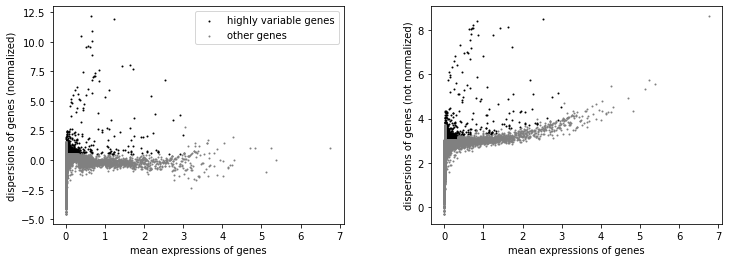

AnnData object with n_obs × n_vars = 3475 × 25675
    obs: 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'doublet_score', 'predicted_doublet', 'Sampleid', 'Patient', 'Sampletype', 'Age_group', 'Gender', 'Cohort', 'Diseasetype', 'Batch', 'Study', 'Nasal_inflammation', 'COVID_severity', 'sampleid', 'soup_correction', 'scrublet_score', 'n_genes', 'is_doublet', 'filter_rna', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'celltypist', 'combined_doublet', 'cellbender_cell', 'leiden', 'broad_label', 'fine_label', 'moderate-severe', 'subset_annotation', 'subset_annotations'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'hvg', 'pca', 'neighbors', 'umap', 'Sampleid_colors', 'Patient_colors', 'Sampletype_colors', 'leiden', 'leiden_colors', 'Gender_colors', 'Cohort_colors', 'ra

In [304]:
# subset
rna_ = adata[adata.obs['leiden'].isin(['14', '18','23'])]
rna_x = sc.AnnData(X = rna_.raw.X, obs = rna_.obs, var = rna_.raw.var, uns = rna_.uns, obsm = rna_.obsm, obsp = rna_.obsp)
rna_x.raw = rna_x
sc.pp.highly_variable_genes(rna_x, min_mean = 0.0125, max_mean = 3, min_disp = 0.5)
sc.pl.highly_variable_genes(rna_x)
rna_x

In [305]:
# subset to highly variable
rna_x = rna_x[:, rna_x.var['highly_variable']]
# regress and scale for PCA
sc.pp.regress_out(rna_x, ['total_counts', 'pct_counts_mt'])
sc.pp.scale(rna_x, max_value = 10)

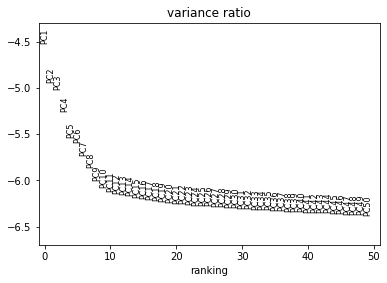

In [306]:
# Principal component analysis
sc.tl.pca(rna_x, svd_solver = 'arpack')
sc.pl.pca_variance_ratio(rna_x, log = True, n_pcs = 50)

In [307]:
# Computing the neighborhood graph. Seurat uses k = 20 as default
sc.pp.neighbors(rna_x, n_neighbors = 10, n_pcs = 50)

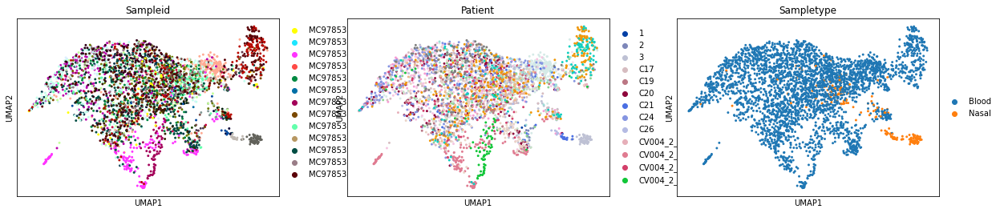

In [308]:
# run UMAP
sc.tl.umap(rna_x, n_components = 2, min_dist = 0.3)
sc.pl.umap(rna_x, color=['Sampleid','Patient', 'Sampletype'])

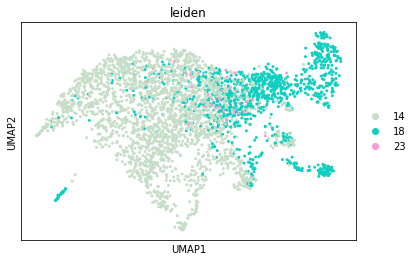

In [309]:
sc.pl.umap(rna_x, color=['leiden'])

In [310]:
# run harmony
sc.external.pp.harmony_integrate(rna_x, 'Patient')
'X_pca_harmony' in rna_x.obsm


2021-07-12 15:36:59,237 - harmonypy - INFO - Iteration 1 of 10
2021-07-12 15:37:02,333 - harmonypy - INFO - Iteration 2 of 10
2021-07-12 15:37:05,337 - harmonypy - INFO - Iteration 3 of 10
2021-07-12 15:37:07,852 - harmonypy - INFO - Iteration 4 of 10
2021-07-12 15:37:10,452 - harmonypy - INFO - Iteration 5 of 10
2021-07-12 15:37:11,954 - harmonypy - INFO - Iteration 6 of 10
2021-07-12 15:37:13,558 - harmonypy - INFO - Iteration 7 of 10
2021-07-12 15:37:15,153 - harmonypy - INFO - Iteration 8 of 10
2021-07-12 15:37:16,638 - harmonypy - INFO - Iteration 9 of 10
2021-07-12 15:37:18,258 - harmonypy - INFO - Iteration 10 of 10
2021-07-12 15:37:19,637 - harmonypy - INFO - Stopped before convergence


True

In [311]:
rna_x

AnnData object with n_obs × n_vars = 3475 × 3184
    obs: 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'doublet_score', 'predicted_doublet', 'Sampleid', 'Patient', 'Sampletype', 'Age_group', 'Gender', 'Cohort', 'Diseasetype', 'Batch', 'Study', 'Nasal_inflammation', 'COVID_severity', 'sampleid', 'soup_correction', 'scrublet_score', 'n_genes', 'is_doublet', 'filter_rna', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'celltypist', 'combined_doublet', 'cellbender_cell', 'leiden', 'broad_label', 'fine_label', 'moderate-severe', 'subset_annotation', 'subset_annotations'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'pca', 'neighbors', 'umap', 'Sampleid_colors', 'Patient_colors', 'Sampletype_colors', 'leiden', 'leiden_colors', 'Gender_colors', 'Cohor

In [312]:
# Computing the neighborhood graph. Seurat uses k = 20 as default
sc.pp.neighbors(rna_x, n_neighbors = 10, n_pcs = 50, use_rep='X_pca_harmony')

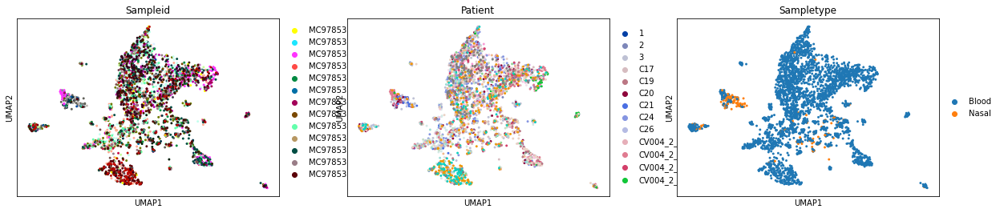

In [313]:
# UMAP
sc.tl.umap(rna_x, n_components = 2, min_dist = 0.3)
sc.pl.umap(rna_x, color=['Sampleid','Patient', 'Sampletype'])

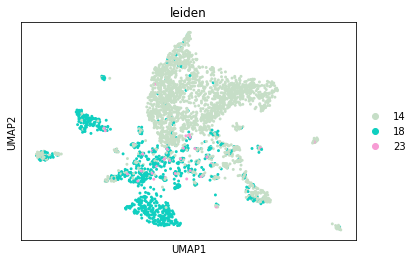

In [314]:
sc.pl.umap(rna_x, color=['leiden'])

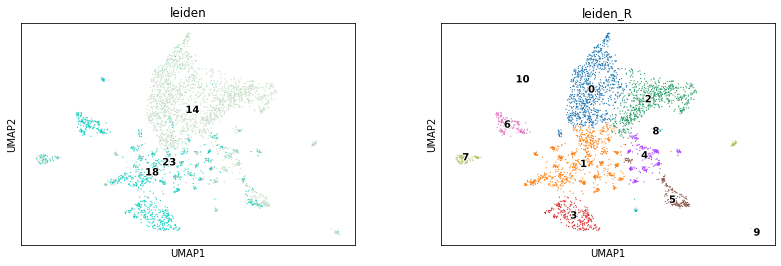

In [318]:
# find clusters
sc.tl.leiden(rna_x, resolution = 0.3, key_added = 'leiden_R')
sc.pl.umap(rna_x, color=['leiden', 'leiden_R'], size=6, legend_loc ='on data', legend_fontoutline=2)

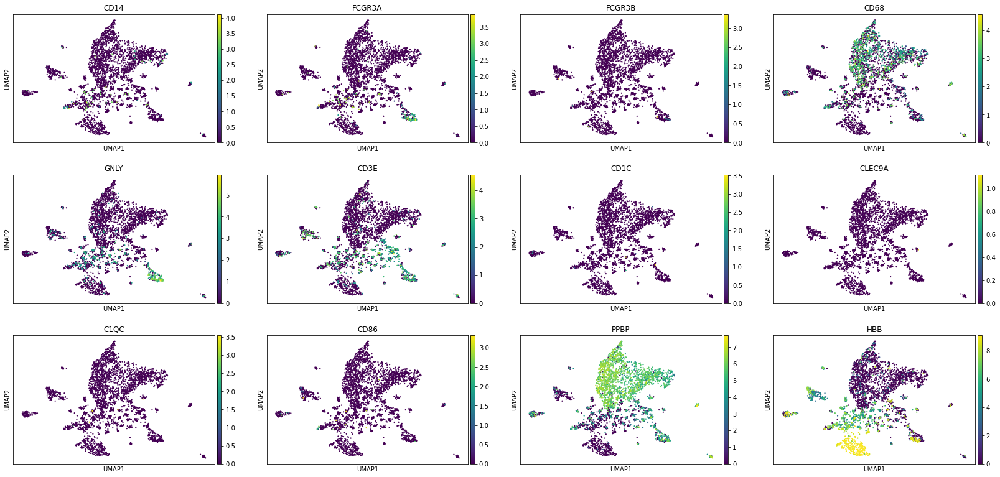

In [316]:
sc.pl.umap(rna_x, color = ['CD14', 'FCGR3A', 'FCGR3B', 'CD68', 'GNLY', 'CD3E', 'CD1C', 'CLEC9A', 'C1QC', 'CD86', 'PPBP', 'HBB'], size = 20)

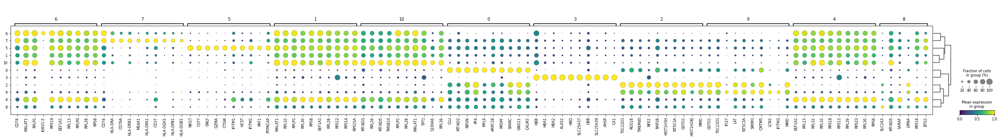

In [319]:
sc.tl.rank_genes_groups(rna_x, groupby = 'leiden_R', method = 'wilcoxon')
sc.tl.filter_rank_genes_groups(rna_x, min_fold_change=1)
sc.tl.dendrogram(rna_x, groupby = 'leiden_R')
sc.pl.rank_genes_groups_dotplot(rna_x, n_genes = 10, standard_scale = 'var', color_map = 'viridis', key = 'rank_genes_groups_filtered')

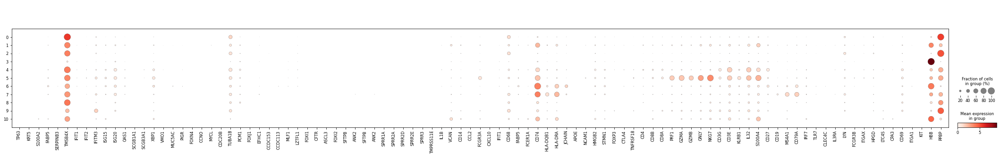

In [320]:
sc.pl.dotplot(rna_x,Chuafeat,groupby ='leiden_R')

... storing 'subset_annotations' as categorical


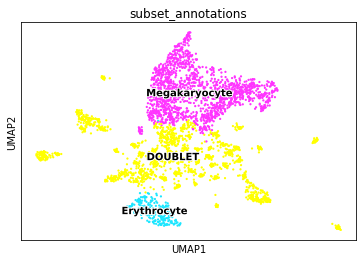

In [321]:
new_dict1 = {'0':'Megakaryocyte',
            '1':'DOUBLET',
            '2':'Megakaryocyte',
            '3':'Erythrocyte',
            '4':'DOUBLET',
            '5':'DOUBLET',
            '6':'DOUBLET',
            '7':'DOUBLET',
            '8':'DOUBLET',
            '9':'DOUBLET',
            '10':'DOUBLET'}
rna_x.obs['subset_annotations'] = [new_dict1[l] for l in rna_x.obs['leiden_R']]
sc.pl.umap(rna_x, color=['subset_annotations'], size=20, legend_loc ='on data', legend_fontoutline=2)

... storing 'subset_annotations' as categorical


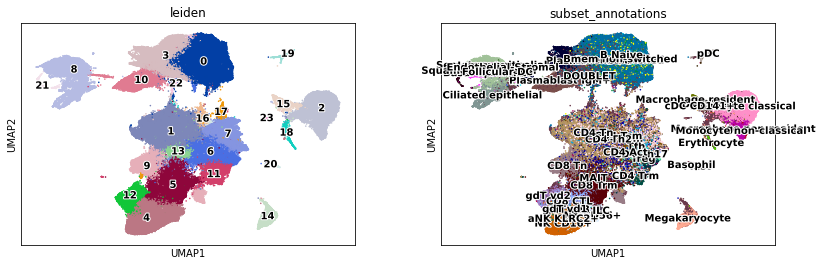

In [322]:
# update the original object
adata.obs['subset_annotations'] = adata.obs['subset_annotations'].astype('object')
adata.obs['subset_annotations'].update(rna_x.obs['subset_annotations'].astype('object'))
sc.pl.umap(adata, color = ['leiden', 'subset_annotations'], size = 10, legend_loc = 'on data', legend_fontoutline=2)

In [323]:
#save for now
adata.write('COV_subsetanno1_120721.h5ad', compression = 'gzip')
adata.raw.to_adata().write('COV_subsetanno1_raw_120721.h5ad', compression = 'gzip')